# Trabalho de Tubulações e Vasos de Pressão

Tema: Projeto de vaso de pressão pelo código ASME

---

### Alunos: Abner Vieira Pereira, Vitor Felipe Toledo e Gabriel Biano Gomes

In [1]:
from numpy import *
import numpy as np
from sympy import *
import sympy as sy
from IPython.display import Image, Video
import matplotlib.pyplot as plt

## Sumário

* Introdução
* Desenvolvimento
* Resultados e discussão
* Referências Bibliográficas

# 1.0 Introdução

Vasos de pressão são equipamentos amplamente utilizados em indústrias de processos, especialmente naqueles que envolvem líquidos e gases sob altas pressões e temperaturas. A concepção segura e eficiente desses equipamentos é de extrema importância, dada a natureza crítica de sua operação. Neste contexto, o código ASME (American Society of Mechanical Engineers) é uma das principais referências internacionais, fornecendo diretrizes rigorosas para o dimensionamento e construção de vasos de pressão.

Neste trabalho, foram aplicadas as equações do código ASME Divisão 1 para o dimensionamento de um vaso de pressão projetado para operar em condições desafiadoras. As dimensões e condições de operação consideradas no projeto são fundamentais para garantir a integridade estrutural e segurança do equipamento ao longo de sua vida útil.


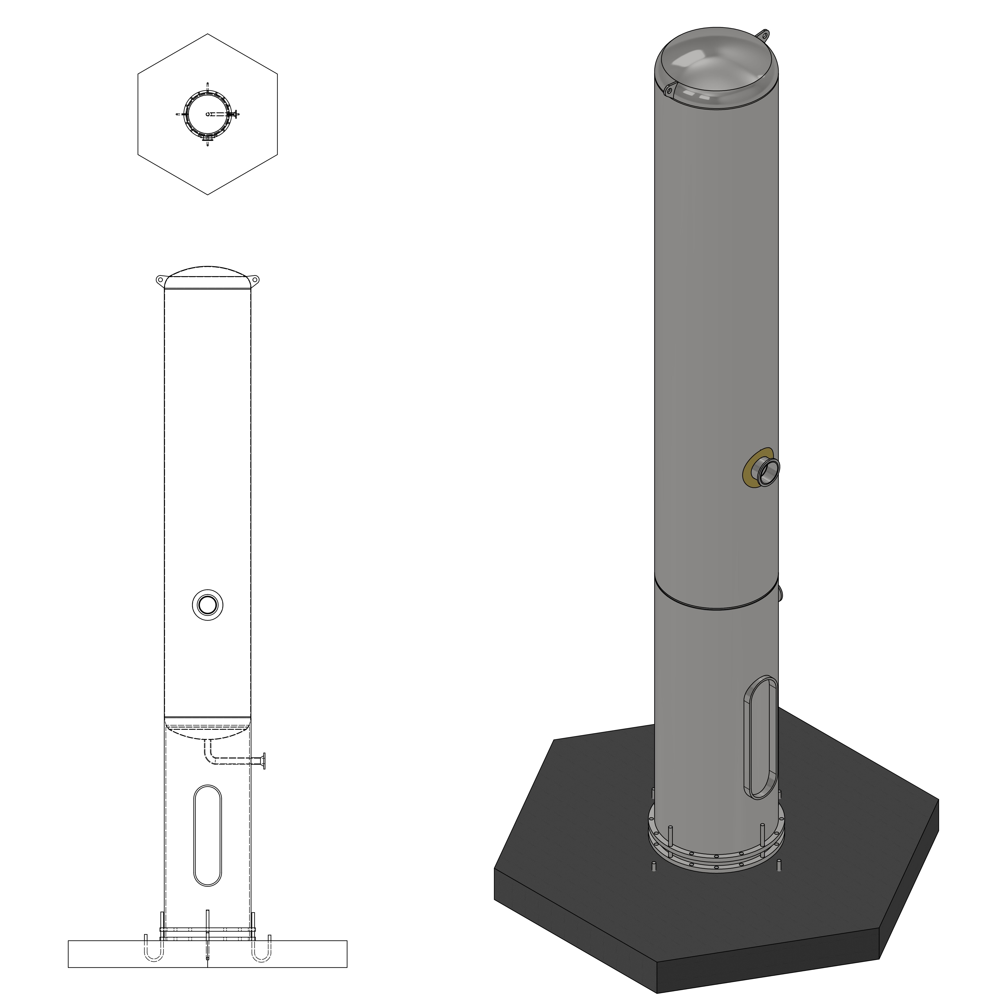

In [2]:
Image('vaso_completo.jpg',width=700)

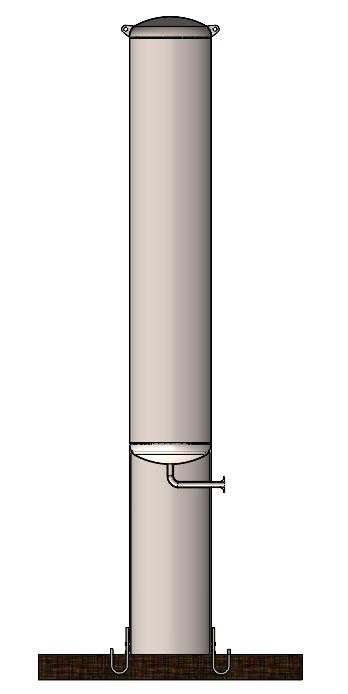

In [3]:
Image('vista_corte_vp.png',width=300)

Para o desenvolvimento do projeto, levou-se em consideração os seguintes parâmetros de entrada:

<!DOCTYPE html>
<html>
<head>
  <style>
    table {
      width: 95%;
      border-collapse: collapse;
      margin: 20px 0;
    }
    th, td {
      border: 1px solid #dddddd;
      text-align: center;
      font-family: Arial, sans-serif;
      padding: 8px;
      box-shadow: 2px 2px 5px rgba(0, 0, 0, 0.1); /* Sombra nas células */
      background-color: transparent; /* Fundo transparente para todas as células */
    }
    th {
      background-color: #28a745; /* Cor de fundo verde */
      color: white; /* Cor do texto em branco */
      font-weight: bold; /* Negrito */
    }
    tr:nth-child(even) {
      background-color: transparent;
    }
  </style>
</head>
<body>

<table>
  <tr>
    <th>Dados do projeto</th>
    <th>Valores</th>
  </tr>
  <tr>
    <td>Raio interno</td>
    <td>1600 mm</td>
  </tr>
  <tr>
    <td>Pressão de projeto</td>
    <td>2,9 kgf/cm²</td>
  </tr>
  <tr>
    <td>Espessura de acréscimo de corrosão</td>
    <td>6 mm</td>
  </tr>
  <tr>
    <td>Temperatura de projeto</td>
    <td>485°C</td>
  </tr>
  <tr>
    <td>Coeficiente de eficiência de soldagem</td>
    <td>0,85</td>
  </tr>
  <tr>
    <td>Redução por conformação</td>
    <td>30%</td>
  </tr>
  <tr>
    <td>Líquido de operação</td>
    <td>Diesel s-10</td>
  </tr>
  <tr>
    <td>Densidade do líquido escolhido</td>
    <td>850 kg/m³</td>
  </tr>
  <tr>
    <td>Altura máxima da coluna de líquido</td>
    <td>3800 mm</td>
  </tr>
  <tr>
    <td>Material das chapas</td>
    <td>SA-516 Gr.60</td>
  </tr>
  <tr>
    <td>Limite de escoamento (temp. ambiente)</td>
    <td>260 MPa</td>
  </tr>
  <tr>
    <td>Pressão de operação</td>
    <td>0,9 kgf/cm²</td>
  </tr>
  <tr>
    <td>Comprimento entre tangentes</td>
    <td>16000 mm</td>
  </tr>
</table>

</body>
</html>



# 2.0 Desenvolvimento

Nesta seção será desenvolvida uma classe com o intuito de fazer o dimensionamento dos componentes usuais de um vaso de pressão com as especificações propostas seguindo a norma ASME, seção VIII, divisão I. Ressalta-se que esse código apenas leva em consideração o efeito da pressão interna ou externa, ficando os demais carregamento a critério do projetista.

As fórmulas desse código são baseadas em teoria de membrana, contendo alguns coeficientes empíricos de correção. Dessa forma, não são levados em consideração os esforços de flexão decorrentes da espessura ou das descontinuidades geométricas

## 2.1.1 Dimensionamento dos tampos

A geometria dos tampos pode ser determinada tendo em perspectiva o valor do diâmetro interno fornecido. O método utilizado para a criação dos tampos consistiu em analisar o catálogo da Codimison, o qual fornecia 2 tipos de tampos elípticos possíveis, sendo eles o NR 21 e NR 65. Neste trabalho, foi selecionado o modelo de tampo NR 21, por conta da sua facilidade de fabricação e suas relações para o raio da coroa (RC) e raio de concordância (RK) serem próximas ao perfil que mais se aproxima de uma elipse, proporcionando um melhor desempenho com as tensões locais.

In [4]:
class dim_Tampo():
    def __init__(self, D):
        self.D = D  # Armazena o valor do diâmetro interno

    def altura_tampo(self):
        # Função que determina a altura de um tampo toriesférico
        h = (self.D)/4

        global H_g
        H_g = h

        return h
    
    def Rc(self):
        # Determinando o raio da coroa "crown"
        Rc = 0.904 * self.D

        global Rc_g
        Rc_g = Rc

        return Rc
        
    
    def Rk(self):
        # Determinando o raio de concordância "knuclke"
        Rk = 0.1725 * self.D

        global Rk_g
        Rk_g = Rk

        return Rk
    
    def Hzao(self):
        # Altura total do tampo
        Hzao = H_g + 40

        return Hzao
    
    def alpha(self):
        C = (Rc_g/2) - Rk_g
        hip = Rc_g - Rk_g

        alpha = np.degrees(np.arctan(C/hip))

        H = np.sqrt((hip**2) - (C**2))

        return alpha, H

In [5]:
tampo_01 = dim_Tampo(3200)

In [6]:
print(f'A altura do tampo é {tampo_01.altura_tampo()} mm.')

A altura do tampo é 800.0 mm.


In [7]:
print(f'O raio da coroa vale {tampo_01.Rc()} mm.')

O raio da coroa vale 2892.8 mm.


In [8]:
print(f'O raio de de concordância (knuckle) vale {tampo_01.Rk()} mm.')

O raio de de concordância (knuckle) vale 552.0 mm.


In [9]:
print(f'A altura total do tampo com o comprimento do trecho reto vale {tampo_01.Hzao()} mm.')

A altura total do tampo com o comprimento do trecho reto vale 840.0 mm.


In [10]:
tampo_01.alpha()

(20.911436349619382, 2163.190532523661)

De posse dessas informações, um breve croqui foi desenhado no AutoCAD:

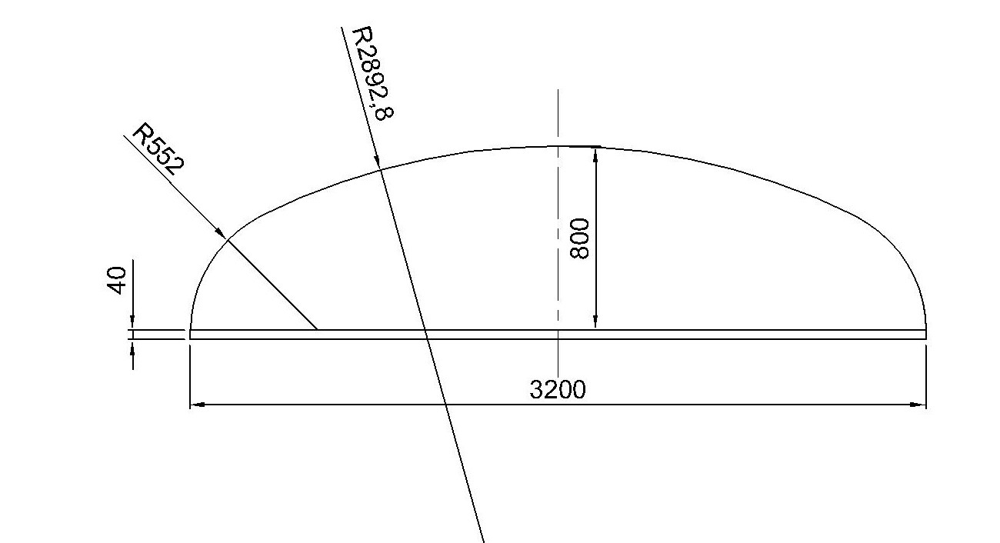

In [11]:
Image('vp-Model.jpg',width=800, height=500)

## 2.1.2 Geometria do casco

A geometria do costado é um cilindro com diâmetro de 3200 mm, com 15920 mm 
de altrua. Note que o comprimento entre tangentes leva em consideração a parte 
reta dos tampos.

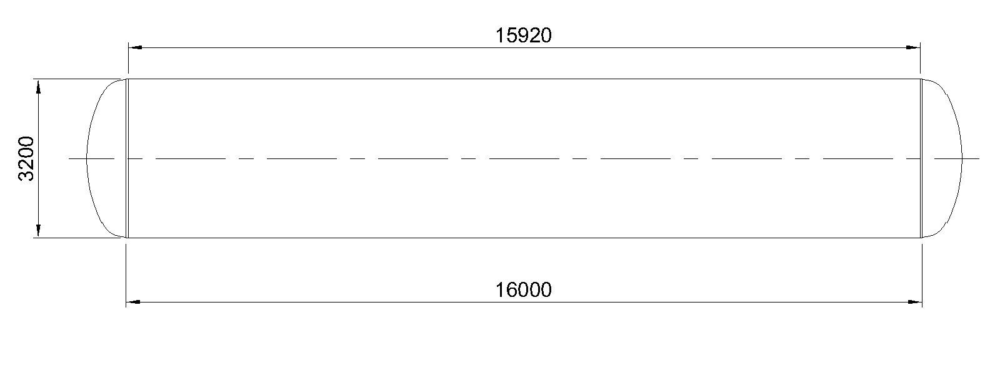

In [12]:
Image('vp_pronto.jpg')

## 2.2 Dimensionamento das espessuras do casco e do tampo:

In [13]:
class dim_VP:
    def __init__(self, R, P, S, E, C, e_com, rho, g, h, h_tampo):
        self.R = R  # Raio interno do cilindro
        self.P = P  # Pressão interna de projeto
        self.S = S  # Tensão admissível básica do material
        self.E = E  # Coeficiente de eficiência da solda
        self.C = C  # Margem para corrosão e/ou para erosão ou usinagem
        self.e_com = e_com  # Espessura comercial
        self.rho = rho  # Densidade do fluido
        self.g = g  # Gravidade
        self.h = h  # Altura da coluna de líquido no costado
        self.h_tampo = h_tampo  # Altura do tampo

    def converte_pressao(self):
        # Função para converter a pressão de kgf/cm^2 para MPa
        return (self.P * 9.80665) / 100

    def P_coluna_fluido(self):
        # Calculando a pressão devido à coluna de fluido no casco
        h_m = self.h / 1000  # Convertendo altura da coluna de fluido de mm para m
        return (self.rho * self.g * h_m) / (10**6)

    def P_tot(self):
        P_convg = self.converte_pressao()
        Pcf_g = self.P_coluna_fluido()
        return Pcf_g + P_convg
    
    def P_tot_tampo(self):
        P_convg = self.converte_pressao()
        h_tampo = self.h_tampo/1000
        Ph_tampo = (self.rho * self.g * h_tampo) / (10**6)
        return Ph_tampo + P_convg

    def verifica_espessura(self):
        # Verificando se a espessura do vaso é grande ou pequena
        P_convg = self.converte_pressao()
        if P_convg > 0.385 * (self.S * self.E):
            print('Vaso de grande espessura!')
        else:
            print('Vaso de pequena espessura!')

    def e_min_casco(self):
        # Para cascos cilíndricos e de pequenas espessuras, a espessura mínima necessária pode ser calculada da seguinte forma:
        P_totg = self.P_tot()
        return ((P_totg * self.R) / ((self.S * self.E) - (0.6 * P_totg))) + self.C
    
    def e_min_tampo(self):
        # Calcula a espessura dos tampos
        P_tot_tampog = self.P_tot_tampo()
        return ((P_tot_tampog * self.R) / ((self.S * self.E) - (0.1 * P_tot_tampog))) + self.C
    
    def e_bocal(self):
        P_totg = self.P_tot()
        return ((P_totg * self.R) / ((self.S * self.E) + (0.4 * P_totg))) + self.C


    def PMTA_casco(self):
        # A pressão máxima de trabalho admissível dos cascos cilíndricos de pequena espessura é dada pela seguinte fórmula:
        return (self.S * self.E * self.e_com) / (self.R + (0.6 * self.e_com))
    
    def PMTA_tampo(self):
        # A pressão máxima de trabalho admissível dos cascos cilíndricos de pequena espessura é dada pela seguinte fórmula:
        return (self.S * self.E * self.e_com) / (self.R + (0.1 * self.e_com))


Antes de instanciar um objeto com a classe '_dim_VP_', é preciso estimar o valor da tensão admissível do projeto com base na temperatura de projeto e no material utilizado. No cenário proposto, temos uma temperatura de 485°C e o material é o aço SA-516 Gr.60. Ao consultar a tabela 10.1 do livro XX, percebemos que existe a necessidade de interpolar valores entre 475°C e 500°C:

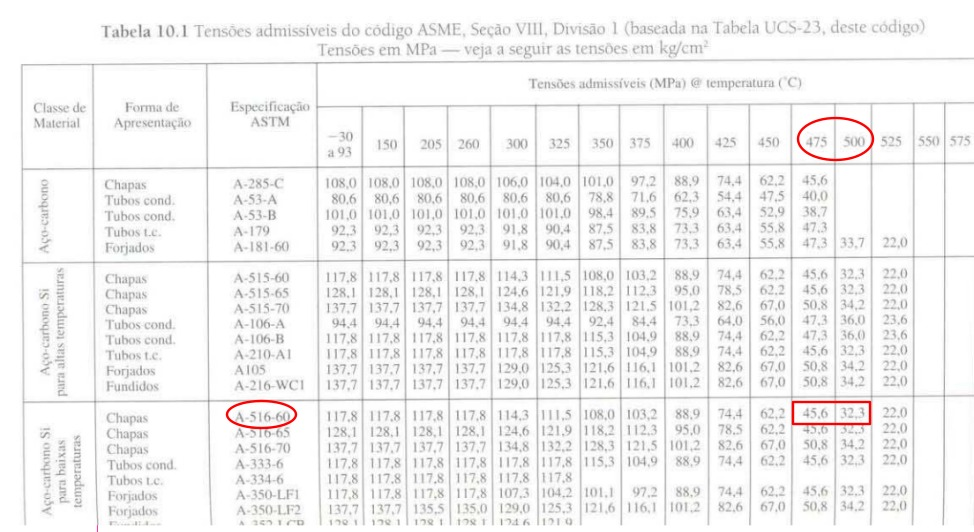

In [14]:
Image("tabela_st.jpeg", width=800, height=600)

In [15]:
# Algoritmo de interpolação:
def Interpol(y1,y2,x1,x,x2):
    y = y1 + (((x - x1)/(x2 - x1)) * (y2 - y1))
    return y

In [16]:
s = Interpol(45.6,32.3,475,485,500)
print(f'A tensão adimssível nesse caso é {s:.2f} MPa.')

A tensão adimssível nesse caso é 40.28 MPa.


Criando o adimissível, (Raio interno, Pressão, tensão adimissível,coef de solda, margem de corrosão, espessura comercial, densidade do fluido, gravidade, altura da coluna de liquido)

In [17]:
VP_01 = dim_VP(1600,2.9,s,0.85,6,0,850,9.81,2960,3800)   # type: ignore 

In [18]:
print(f'A pressão de projeto em MPa é {VP_01.converte_pressao():.4f}.')

A pressão de projeto em MPa é 0.2844.


O código ASME faz uma distinção entre os cascos cilíndricos de pequena e de grande espessura (essas informações são encontradas no parágrafo UG-27). Os vasos de grande espessura apresentam cascos aonde _e_ > 1/2 R, ou P > 0,385 SE. Como não conhecemos a espessura do casco ainda, verificar-se-á essa teoria por meio da segunda condição.

In [19]:
VP_01.verifica_espessura()

Vaso de pequena espessura!


Para os casos de cascos cilíndricos de pequena espessura, pode-se determinar a espessura mínima necessário através da fórmula:

$$ \textit{e} = \frac{PR}{SE - 0,6P} + C$$

_e_ = espessura mínima para pressão interna</br>
R = raio interno do cilíndro</br>
P = pressão interna do projeto</br>
S = tensão admissível básica do material</br>
E = coeficiente de eficiência de solda

A coluna de exerce uma pressão sobre o casco que pode ser determinada pela Lei de Stevin, que enuncia que $P_H = \rho  g  h$, aonde:

* $\rho $ é a densidade do fluido;
* $g$ é a aceleração da gravidade; 
* $h$ é a altura da coluna de fluido

In [20]:
print(f' A pressão devido à coluna de fluido é {VP_01.P_coluna_fluido():.4f} MPa.')

 A pressão devido à coluna de fluido é 0.0247 MPa.


A pressão total do projeto, então, corresponde à soma entre os valores da pressão de projeto com a pressão exercida pela coluna de fluido:

$$ P_{tot} = P_{proj} + P_{H}$$

In [21]:
print(f'A pressão total de projeto é {VP_01.P_tot():.4f} MPa.')

A pressão total de projeto é 0.3091 MPa.


In [22]:
print(f'A espessura mínima teórica do casco é {VP_01.e_min_casco():.4f} mm.')

A espessura mínima teórica do casco é 20.5222 mm.


### 2.2.1 Espessuras comerciais do vaso

Os valores das espessuras comerciais das chapas foram retiradas do site da empresa [Cia do Ferro](https://ciadoferro.com.br/chapas/):

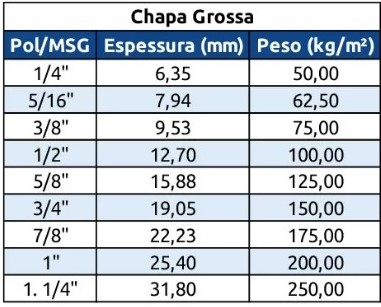

In [23]:
Image('t_comerciais.jpeg',width=500)

### 2.2.2 Espessuras na condição novo/frio:

#### 2.2.2.1 Espesura do casco

A espessura do vaso novo e frio é tomada como o valor da chapa comercial que possui um valor maior que a espessura teórica:

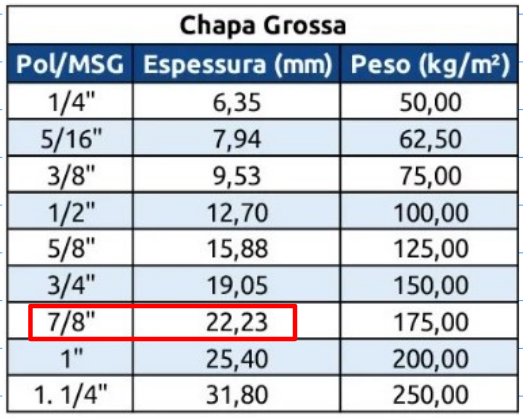

In [24]:
Image('tc_casco.png')

### 2.2.2.2 Espessura dos tampos

Já a espessura dos tampos elípticos com relação de semi-eixos 2:1 é dado pela seguinte fórmula:

$$\textit{e} =  \frac{PR}{SE - 0,1P} + C $$

E, pelo fato de sofrerem uma perda de 30% no processo de rebordeamento, é conveniente calculá-la com esse acréscimo para encontrar uma chapa comercial com a espessura adequada:

In [25]:
print(f'A espessura dos tampos é {1.3 * VP_01.e_min_tampo():.4f} mm.')

A espessura dos tampos é 27.0199 mm.


Dessa forma, ao analisar o catálogo da Cia do Ferro, percebe-se que a espessura comercial mais adequada é a de 31,80 mm.

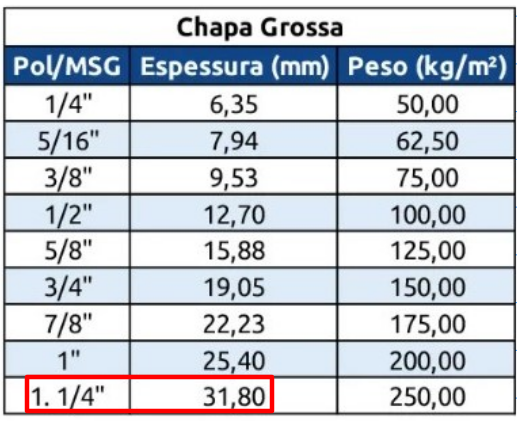

In [26]:
Image('tc_tampos.png')

### 2.2.3 Espessuras na condição quente/corroído

Quando um vaso de pressão fica operando em condições de corrosão e alta temperatura, é necessário levar em conta que a espessura sofre perdas, que, conforme o enunciado para este caso, corresponde a 6 mm. Isto é, no final da vida útil do vaso de pressão a chapa comprada terá 6 mm a menos do que no começo da sua vida útil.

#### 2.2.3.1 Espessura do casco

In [27]:
print(f'A espessura mínima teórica do casco é {(22.23 - 6):.2f} mm.')

A espessura mínima teórica do casco é 16.23 mm.


#### 2.2.3.1 Espessura dos tampos

In [28]:
print(f'A espessura dos tampos é {(31.8- 6):.2f} mm.')

A espessura dos tampos é 25.80 mm.


## 2.2.4 Resumo das espessuras

Abaixo, segue uma tabela com o resumo das espessuras determindadas:

<!DOCTYPE html>
<html>
<head>
  <style>
    table {
      width: 95%;
      border-collapse: collapse;
      margin: 20px 0;
    }
    th, td {
      border: 1px solid #dddddd;
      text-align: center;
      font-family: Arial, sans-serif;
      padding: 8px;
      box-shadow: 2px 2px 5px rgba(0, 0, 0, 0.1); /* Sombra nas células */
      background-color: transparent; /* Fundo transparente para todas as células */
    }
    th {
      background-color: #0f20d6;
      color: white; /* Cor do texto em branco */
      font-weight: bold; /* Negrito */
    }
    tr:nth-child(even) {
      background-color: transparent;
    }
  </style>
</head>
<body>

<table>
  <tr>
    <th>Espessura das chapas</th>
    <th>Cilíndro</th>
    <th>Tampo</th>
    <th>Tampo pós-processo de fabricação</th>
  </tr>
  <tr>
    <td><strong>Teórica</strong></td>
    <td>20,5222 mm</td>
    <td>27,0199 mm</td>
    <td>-</td>
  </tr>
  <tr>
    <td><strong>Novo/Frio</strong></td>
    <td>22,23 mm</td>
    <td>31,80 mm</td>
    <td>22,26 mm</td>
  </tr>
  <tr>
    <td><strong>Corroído/Quente</strong></td>
    <td>16,23 mm</td>
    <td>16,26 mm</td>
    <td> - </td>
  </tr>
</table>

</body>
</html>

## 2.3 Cálculo das Pressões Máxima de Trabalho Admissível (PMTA)


A Pressão Máxima de Trabalho Admissível (PMTA), também conhecida como Maximum Allowable Working Pressure (MAWP) em inglês, é um conceito fundamental na engenharia de vasos de pressão. Trata-se da máxima pressão que um vaso pode suportar de forma segura durante a operação, levando em consideração diversos fatores de projeto, como a resistência dos materiais, as condições de temperatura e a configuração geométrica do equipamento.

No contexto de projetos industriais, a PMTA é uma medida crucial para garantir a segurança e eficiência dos vasos de pressão. Ela define os limites operacionais que não podem ser excedidos e serve como base para o monitoramento contínuo do equipamento durante sua operação. A conformidade com a PMTA garante que o vaso de pressão possa operar de forma confiável sob as condições projetadas, minimizando o risco de falhas catastróficas.

### 2.3.1 Cálculo das PMTAs no cilíndro:

A PMTA é descrita pela seuinte relação:

$$ PMTA = \frac{SE \textit{e}}{R + 0,6\textit{e}}$$

#### 2.3.1.1 PMTA do casco na condição novo/frio:

A espessura comercial adotada pelos projetistas é 22,23 mm. Dessa forma, criar-se-á um novo objeto para fazer o cálculo da PMTA.

In [29]:
VP_02 = dim_VP(1600,2.9,s,0.85,6,22.23,850,9.81,2960,3800)

In [30]:
print(f'A PMTA para o projeto na condição de novo/frio é {VP_02.PMTA_casco():.4f} MPa ou {(VP_02.PMTA_casco()*10.1972):.4f} kgf/cm^2.')

A PMTA para o projeto na condição de novo/frio é 0.4718 MPa ou 4.8106 kgf/cm^2.


#### 2.3.1.2 PMTA na condição quente/corroído

In [31]:
VP_03 = dim_VP(1600,2.9,s,0.85,0,16.23,850,9.81,2960,3800)

In [32]:
print(f'A PMTA para o projeto na condição de corroído/quente é {VP_03.PMTA_casco():.4f} MPa ou {(VP_03.PMTA_casco()*10.1972):.4f} kgf/cm^2.')

A PMTA para o projeto na condição de corroído/quente é 0.3452 MPa ou 3.5201 kgf/cm^2.


### 2.3.1 Cálculo das PMTAs nos tampos:

A pressão máxima de trabalho admissível nos tampos toriesféricos será:

$$PMTA = \frac{SE\textit{e}}{R + 0,1\textit{e}}$$

#### 2.3.1.1 PMTA na condição novo/frio:

In [33]:
VP_04 = dim_VP(1600,2.9,s,0.85,6,22.26,850,9.81,2960,3800)

In [34]:
print(f'A PMTA para os tampos na condição de novo/frio é {VP_04.PMTA_tampo():.4f} MPa ou {(VP_04.PMTA_tampo()*10.1972):.4f} kgf/cm^2.')

A PMTA para os tampos na condição de novo/frio é 0.4757 MPa ou 4.8505 kgf/cm^2.


#### 2.3.1.2 PMTA na condição quente/corroído:


In [35]:
VP_05 = dim_VP(1600,2.9,s,0.85,0,16.26,850,9.81,2960,3800)

In [36]:
print(f'A PMTA para os tampos na condição de quente/corroído é {VP_05.PMTA_tampo():.4f} MPa ou {(VP_05.PMTA_tampo()*10.1972):.4f} kgf/cm^2.')

A PMTA para os tampos na condição de quente/corroído é 0.3476 MPa ou 3.5444 kgf/cm^2.


## 2.3.2 Resumo das PMTAs

Abaixo, segue uma tabela com o resumo das espessuras determindadas:

<!DOCTYPE html>
<html>
<head>
  <style>
    table {
      width: 95%;
      border-collapse: collapse;
      margin: 20px 0;
    }
    th, td {
      border: 1px solid #dddddd;
      text-align: center;
      font-family: Arial, sans-serif;
      padding: 8px;
      box-shadow: 2px 2px 5px rgba(0, 0, 0, 0.1); /* Sombra nas células */
    }
    th {
      background-color: #0f20d6;
      color: white; /* Cor do texto em branco */
      font-weight: bold; /* Negrito */
    }
    tr:nth-child(even) {
      background-color: transparent;
    }
  </style>
</head>
<body>

<table>
  <tr>
    <th>PMTA</th>
    <th>Cilíndro</th>
    <th>Tampo</th>
  </tr>
  <tr>
    <td>Novo/Frio</td>
    <td>0,4718 MPa</td>
    <td>0,4757 MPa</td>
  </tr>
  <tr>
    <td>Corroído/Quente</td>
    <td>0,3378 MPa</td>
    <td>0,3476 MPa</td>
  </tr>
</table>

</body>
</html>



## 2.4 Pressão no teste hidrostático

Para os vasos construídos de acordo com o código ASME, Seção VIII, Div.1, a pressão de teste deve ser no mínimo 1,3 vezes a PMTA do vaso (correspondente a espessura corroída), segundo o parágrafo UG-99 dessa norma.

In [37]:
print(f'A pressão de teste hisdrostático equivale à {1.3 * 0.3378} MPa.')

A pressão de teste hisdrostático equivale à 0.43914 MPa.


In [38]:
x = 220*0.9
x

198.0

## 2.5 Estimativa do peso

O cálculo do peso da estrutura é feito através da multiplicação do volume total das chapas da estrutura pelo seu peso específico:

$$P = V \gamma$$

O peso epecífico dos aços carbono é aproximadamente 7850 kgf/m^3, com algumas variações dependendo da composição do aço. Já, o volume total das chapas foi determinado a partir de uma modelagem feita no $\textit{software}$ Inventor.

In [39]:
def Peso(V, gamma):
    # V -> valor do volume em m^3
    # gamma -> peso específico em kgf
    P = V*gamma
    
    return P

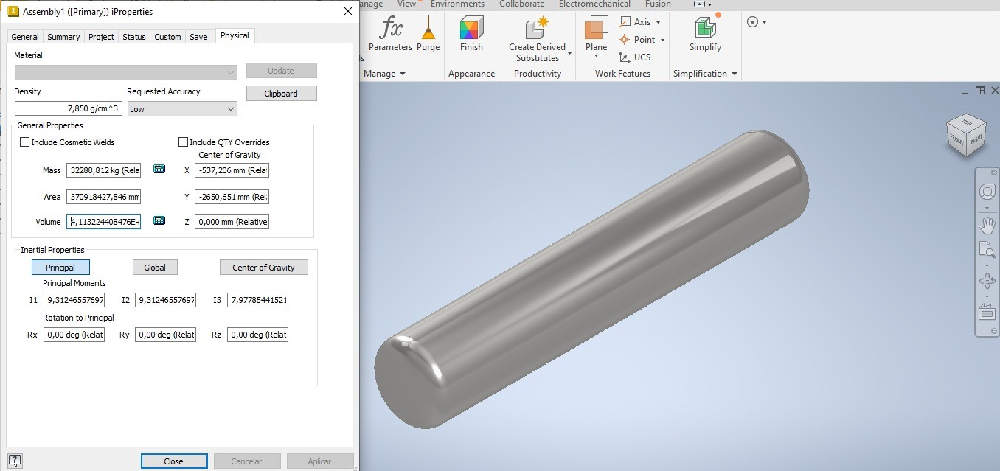

In [40]:
Image("volume_vaso.jpeg")

### 2.5.1 Peso na condição vazio/transporte

Nessa condição, não há fluido de trabalho inserido no vaso. Dessa forma, o peso calculado é somente da estrutura metálica

In [41]:
peso_vaso_vazio = Peso(4.1132,7850)
print(f'O peso do vaso na condição vazio/transporte é {peso_vaso_vazio:.2f} kgf.')

O peso do vaso na condição vazio/transporte é 32288.62 kgf.


### 2.5.2 Peso na condição de operação

Nesse caso, é preciso contablizar o peso referente à coluna de fluido - que possui uma altura de 3800 mm -, além do peso da estrutura metálica.

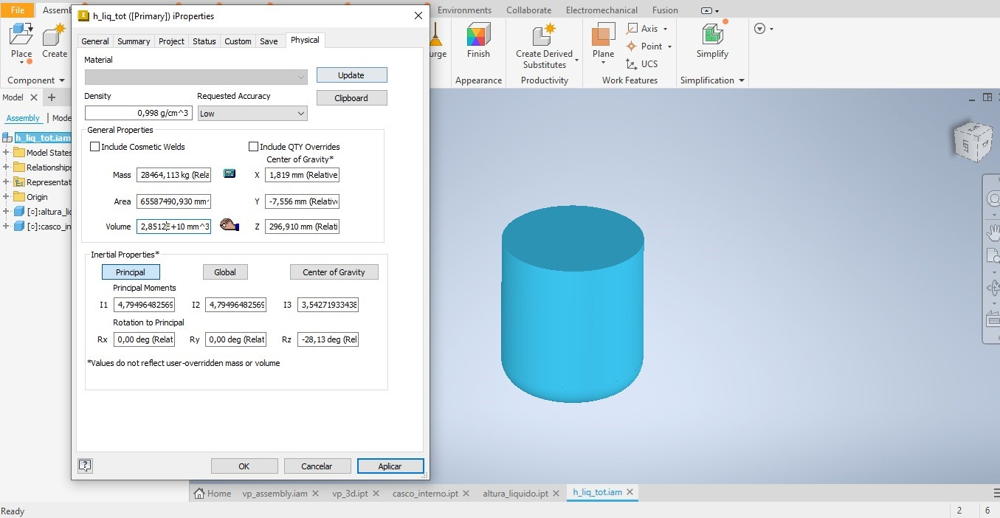

In [42]:
Image("vol_líq.jpeg")

In [43]:
peso_liq_op = Peso(28.512,850)
print(f'O peso do vaso na condição de operação é {(peso_vaso_vazio + peso_liq_op):.2f} kgf.')

O peso do vaso na condição de operação é 56523.82 kgf.


### 2.5.3 Peso na condição de teste

Nessa condição, somou-se os valor do peso do vaso com o valor do peso do vaso cheio d'água.

In [44]:
peso_teste_hd = Peso(137.45,1000)
print(f'O peso do vaso na condição de operação é {(peso_teste_hd + peso_vaso_vazio):.2f} kgf.')

O peso do vaso na condição de operação é 169738.62 kgf.


## 2.6 Estimativa do custo do equipamento

Para calcular o preço do equipamento consultou-se o site de venda [Alibaba](https://www.alibaba.com/product-detail/Plate-Sheet-High-Carbon-Steel-Sheet_1600071139385.html?s=p), aonde comprar chapas de aço AS 516 gr 60 por 
tonelada. Dessa forma pegou-se o valor total da massa do vaso e multiplicou-se pelo valor do aço / TON. A tabela abaixo exibe uma estimativa do custo total do equipamento.


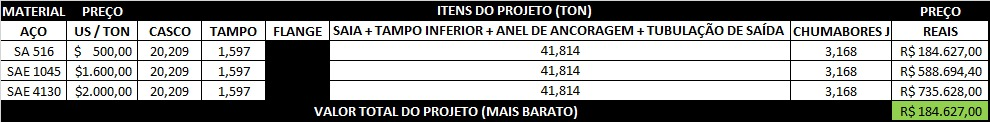

In [45]:
Image('preços_final.jpeg')

## 2.7 Classificação do vaso

A classificação dos vasos de pressão é feita segundo a Norma Regulamentadora NR-13, estabelecida pelo Ministério do Trabalho e Emprego do Brasil, que foi instituída com o objetivo de garantir a segurança na operação e manutenção de caldeiras, vasos de pressão e tubulações.

O vaso de pressão proposto se enquadra em alguns campos de aplicação, tais como:

* Caldeiras com pressão de operação superior a 0,61 kgf/cm² (o do vaso proposto é 0,9 kgf/cm²);
* Vasos de pressão cujo produto P.V seja superior a 8 (oito), onde P é o módulo da 
pressão máxima de operação em kPa e V o seu volume interno em m³;

Essa classificação é feita em três categorias: Classe, que é baseado no fluido de operação, Grupo de risco  e Categoria, que é uma consequência dos outros dois, e é determinada de acordo com a tabela XX. 


In [46]:
class NR_13():
    def __init__(self, P, V):
        self.P = P
        self.V = V

    def PV(self):
        PV = (98.0665*self.P) * (self.V * 10**-9)

        return PV

Para determinar o volume interno do vaso, foi feito um modelo no Inventor

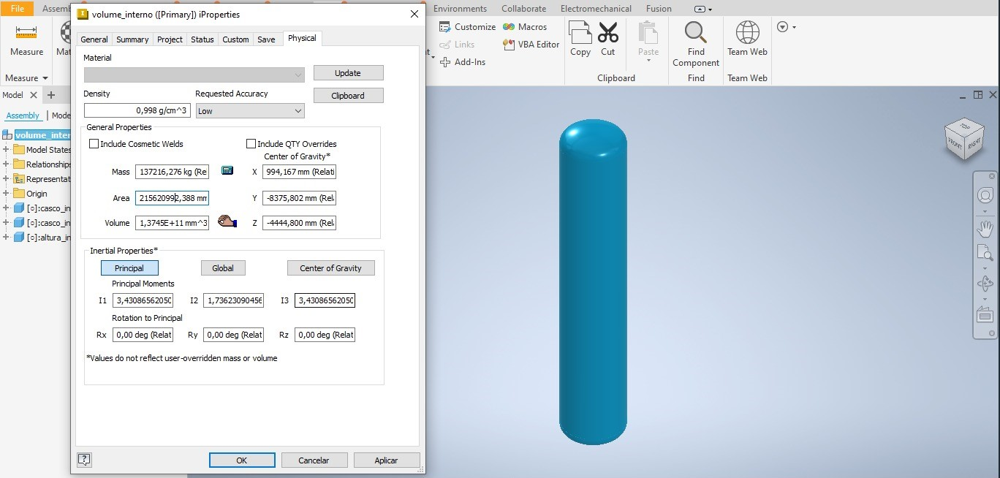

In [47]:
Image('volume_interno.jpeg')

In [48]:
vaso_nr = NR_13(0.9, (1.3745*10**11))

In [49]:
print(f' O produto PV é {vaso_nr.PV():.2f}.') # type: ignore

 O produto PV é 12131.32.


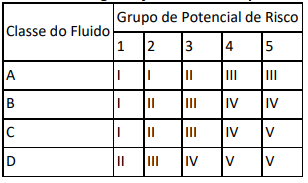

In [50]:
Image('tab_classificação.png')

<style>
  table {
    width: 95%;
    border-collapse: collapse;
  }
  th, td {
    border: 1px solid #dddddd;
    text-align: center;
    font-family: Arial, sans-serif;
    padding: 8px;
    box-shadow: 2px 2px 5px rgba(0, 0, 0, 0.1); /* Sombra nas células */
  }
  th {
    background-color:#f70c0c;
    font-weigth:bold; /* negrto */
  }
  tr:nth-child(even) {
    background-color: transparent;
  }
</style>

<table>
  <tr>
    <th>Classe</th>
    <th>Grupo</th>
    <th>Categoria</th>
  </tr>
  <tr>
    <td>A</td>
    <td>1</td>
    <td>  <i>I</i> </td>
  </tr>
</table>

 

- A Classe do vaso é A, pois estamos lidando com fluido inflamável (diesel) a uma temperatura superior à 200°C;
- O grupo de risco do vaso é 1, pois o produto PV > 100;

## 2.8 Dimensionamento do suporte do vaso

A saia  é um suporte que envolve a parte inferior do vaso, garantindo estabilidade e distribuição uniforme das tensões. Esse tipo de suporte é ideal para vasos altos e pesados, pois transfere as cargas de vento e peso para a fundação. A saia é geralmente soldada ao vaso e fixada ao solo por meio de parafusos de ancoragem. Sua construção permite uma maior flexibilidade ao absorver esforços térmicos, reduzindo o risco de deformações e falhas estruturais.

Para dimensionar a saia, seguiu-se a recomendação de projeto abaixo:

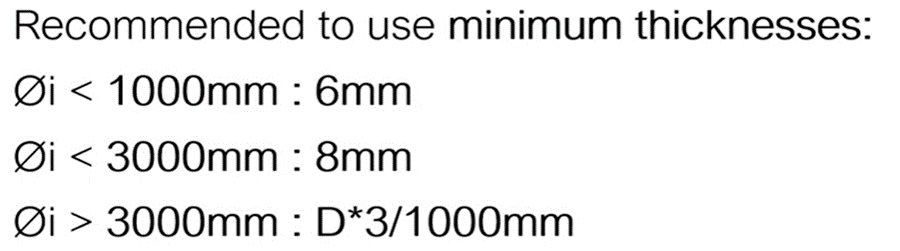

In [51]:
Image('rec_saia.png')

In [52]:
print(f'A espessura mínima da saia é {(3200*3)/1000} mm.')

A espessura mínima da saia é 9.6 mm.


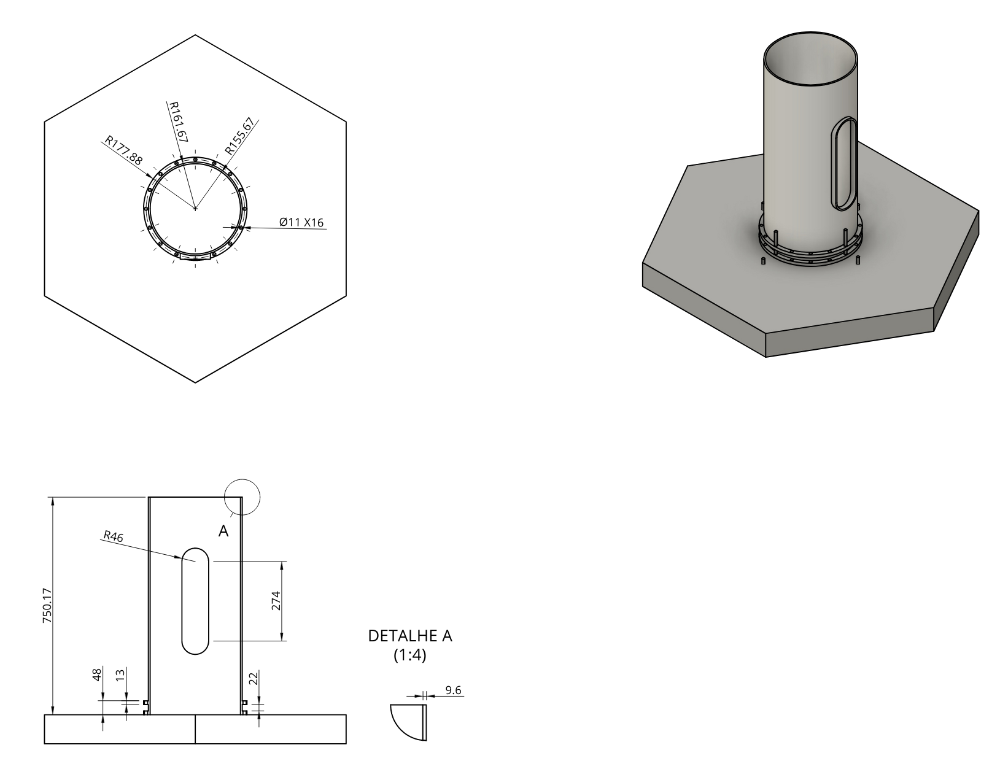

In [53]:
Image('prancha_saia.png',width=700)

Mais adianta, será mostrado uma análise por elementos finitos para checar a possibilidade de flambagem desta saia.

## 2.9 Análise de tensão no bocal pelo WRC-107

O WRC-107, ou "Welding Research Council Bulletin 107", é um documento técnico que fornece diretrizes para a avaliação de tensões em vasos de pressão e tubulações devido à presença de cargas externas aplicadas em bicos, bocais e outras conexões. Ele é amplamente utilizado na indústria de engenharia de pressão para analisar tensões localizadas causadas por forças e momentos aplicados em pontos de conexão de vasos de pressão, que podem resultar em concentrações de tensões.

### 2.9.1 Dimensionamento do bocal

In [54]:
Bocal = dim_VP(304.8,2.9,s,0.85,6,0,0,0,0,0)

In [55]:
Bocal.verifica_espessura()

Vaso de pequena espessura!


A espessura da parede do bocal são determinados segundo o parágrafo UG-37 do código ASME pela fórmula:

$$ \textit{t} = \frac{PR}{SE + 0,4P} + C$$

In [56]:
print(f'A espessura mínima teórica para a parede do bocal é {Bocal.e_bocal():.2f} mm')

A espessura mínima teórica para a parede do bocal é 8.52 mm


A norma N-253 da Petrobras estabelece que há a necessidade de tubos sem custuras até 12". Dessa forma, como o bocal proporto tem diâmetro de 24", pode-se calandrar uma chapa para fabricar o bocal.

A chapa usada neste caso terá espessura do costado para fazer o bocal por questões de economia, ou seja, 22,23 mm.

A projeção externa do bocal pode ser determinada levando em consideração a norma da Petrobras N-253:

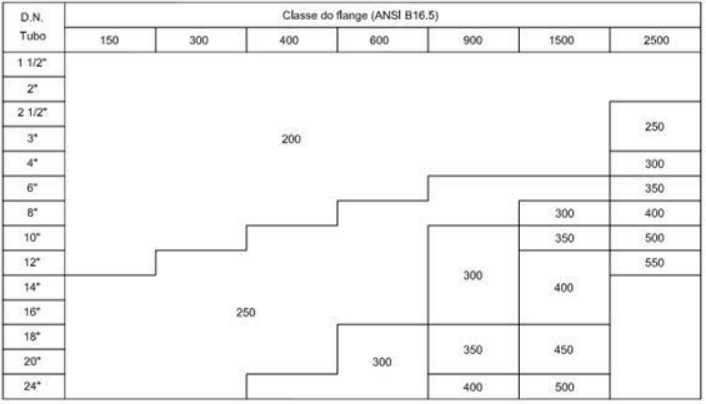

In [57]:
Image('projeção_bocal.png')

Segundo os dados fornecidos pelo enunciado, DN = 24" e a classe do flange = 150. Portanto, a projeção do bocal é 250 mm.

### 2.9.2 Reforço nos bocais


O reforço nos bocais é realizado através de um método conhecido como compressão de áreas, que será mostrado na figura abaixo:

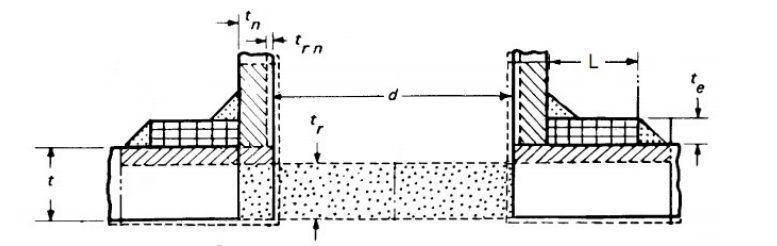

In [58]:
Image('reforço.png',width=700)

Onde:

**tn:** Espessura nominal da parede do tubo;

**tr:** Espessura mínima do casco/tampo;

**te:** Espessura do anel de reforço;

**$t_{rn}$:** Espessura mínima da parede do tubo;

**t:** Espessura mínima da parede do tubo;

**d:** Diâmetro do bocal;

**L:** Largura do anel de reforço.

Pode-se estimar quatro tipos de área, a partir da figura abaixo:

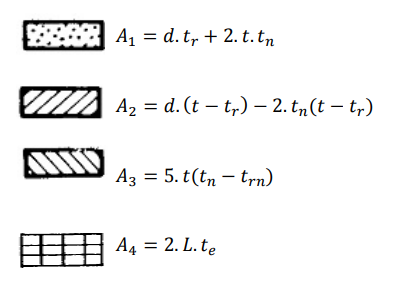

In [59]:
Image('tipos_de_area.png')

Onde:

**$A_1$** é a área requerida;

**$A_2$** é a área disponível no casco/tampo;

**$A_3$** é a área disponível na projeção do bocal;

**$A_4$** é a área disponível pelo anel de reforço. 

Após o cálculo das áreas acima, é possível estabelecer uma condição para verificar se o reforço é necessário no bocal:

$$A_2 + A_3 > A_1$$

Se a condição for satisfeita, o bocal não precisa ser reforçado, caso contrário o anel de reforço se faz necessário.

A áres do anel de reforço é indicada por A4, que proporciona uma nova condição para verificar se o reforço dimensionado atende às exigências do bocal:

$$A_2 + A_3 + A_4 > A_1$$

Se a condição acima for satisfeita, o anel de reforço pode ser considerado, caso contrário é necessário redimensionar.

Durante o dimensionamento dos bocais existem algumas exigências da norma ASME que devem ser rigorosamente seguidas:
* Para efeito de cálculo a projeção externa máxima deve ser 2,5 vezes a espessura;
* A espessura máxima da chapa do anel de reforço é igual a espessura da chapa onde o bocal está sendo instalado;
* A largura máximo do anel de reforço não deve exceder o diâmetro interno do bocal.

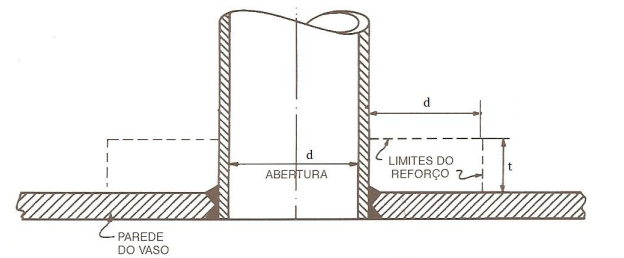

In [60]:
Image('limites_bocais.png')

Fonte: Moss, Dennis R., Pressure-Vessel Design and Construction, 2004

In [61]:
class Reforço:
    def __init__(self, tn, tr, te, trn, t, d):
        self.tn = tn    # Espessura nominal da parede do tubo
        self.tr = tr    # Espessura mínima do casco/tampo
        self.te = te    # Espessura do anel de reforço
        self.trn = trn  # Espessura mínima da parede do tubo
        self.t = t      # Espessura mínima da parede do tubo
        self.d = d      # Diâmetro do bocal

    def A_1(self):
        # Calcula a área requerida
        A1 = self.d * self.tr + (2 * self.t * self.tn)
        global A1_g
        A1_g = A1
        return A1

    def A_2(self):
        # Calcula a área disponível no casco/tampo
        A2 = (self.d * (self.t - self.tr)) - (2 * self.tn * (self.t - self.tr))
        global A2_g
        A2_g = A2
        return A2

    def A_3(self):
        # Calcula a área disponível na projeção do bocal
        A3 = 5 * self.t * (self.tn - self.trn)
        global A3_g
        A3_g = A3
        return A3

    def Verifica_Reforço(self):
        A3_g = 0
        if A2_g + A3_g > A1_g:
            print('Não é necessário realizar reforço no bocal!')
        else:
            print('Há a necessidade de realizar reforço sobre o bocal!')

    def L(self, te):
        l = ((self.d * self.tr) +  (2 * self.t * self.tn) - (self.d * (self.t - self.tr)) + (2 * self.tn * (self.t - self.tr)) - (5 * self.t * (self.tn - self.trn))) / (2 * te)
        return l 

In [62]:
te = sy.symbols('te')

In [63]:
reforço_bocal = Reforço(22.23, 20.522, te, 8.44, 22.23, 609.6) # type: ignore

In [64]:
print(f'A1 = {reforço_bocal.A_1():.2f} mm^2.')

A1 = 13498.56 mm^2.


In [65]:
print(f'A2 = {reforço_bocal.A_2():.2f} mm^2.')

A2 = 965.26 mm^2.


In [66]:
reforço_bocal.Verifica_Reforço()

Há a necessidade de realizar reforço sobre o bocal!


A largura mínima do reforço necessário pode ser calculada por:

$$L = \frac{dt_r + 2tt_n - d(t - t_r) + 2t_n(t - t_r) - 5t(t_n-t_{rn})}{2t_e}$$

In [67]:
L_expr = reforço_bocal.L(te)
L_func = sy.lambdify(te, L_expr, modules='numpy')

In [68]:
te_values = np.linspace(20, 50, 1000)
L_values = L_func(te_values)

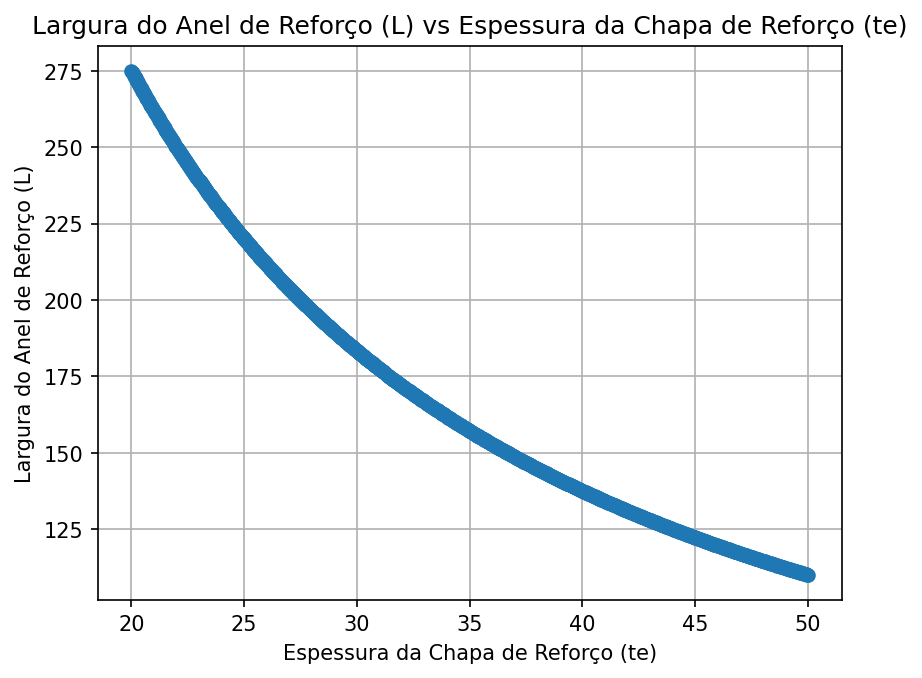

In [69]:
plt.figure(dpi=150)
plt.plot(te_values, L_values, marker='o')
plt.xlabel('Espessura da Chapa de Reforço (te)')
plt.ylabel('Largura do Anel de Reforço (L)')
plt.title('Largura do Anel de Reforço (L) vs Espessura da Chapa de Reforço (te)')
plt.grid(True)
plt.show()

Adotando valores para o comprimento, levando em conta que não é ideal escolher uma largura de reforço muito pequeno devido à dificuldade de adequação à geometria do vaso de pressão na hora de sua instalação. 

In [70]:
L_teste = reforço_bocal.L(22.23)
print(f'O valor da largura do anel de reforço é {L_teste:.2f} mm.')

O valor da largura do anel de reforço é 247.43 mm.


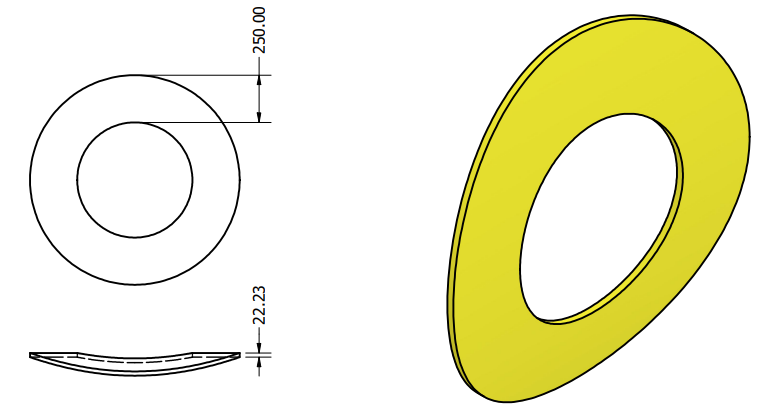

In [71]:
Image('anel_prancha.png')

Tendo dimensionado o reforço agora é preciso determinar se esse reforço é capaz de aliviar as tensões, e para verificar isso, é preciso ver se $A_2$ + $A_3$ + $A_4$ > $A_1$.

In [72]:
class qualidade_reforço():
    def __init__(self, A1, A2, A3, te, L):
        self.A1 = A1
        self.A2 = A2
        self.A3 = A3
        self.te = te
        self.L = L
        
    def A_4(self):
        A4 = 2 * self.L * (self.te) * self.te

        global A4_g
        A4_g = A4

        return A4
    
    def criterio_reforço(self):
        if (self.A2 + self.A3 + A4_g) > self.A1:
            print(f'Como {(self.A2 + self.A3 + A4_g):.2f} é maior que {self.A1:.2f} o anel de reforço satisfaz o critério ASME.')
        else:
            print(f'Como {(self.A2 + self.A3 + self.A4_g):.2f} é menor que {self.A1:.2f}, existe a necessidade de se refazer o dimensionamento do anel de reforço.')


In [73]:
anel_reforço = qualidade_reforço(reforço_bocal.A_1(),reforço_bocal.A_2(),0,19.05, L_teste )

In [74]:
print(f'A4 = {anel_reforço.A_4():.2f} mm^2.')

A4 = 179582.69 mm^2.


In [75]:
anel_reforço.criterio_reforço()

Como 180547.95 é maior que 13498.56 o anel de reforço satisfaz o critério ASME.


### 2.9.3 Análise de tensões pela WRC 107

Nesta análise, a primeira etapa consiste em fazer o dimensionamento da espessura do bocal. Em seguida é preciso calcular dois parâmetros.

O primeiro é o Parâmetro de Casca (Shell Parameter), que é dado pela letra grega $\gamma$. A fórmula é:

$$ \gamma = \frac{R_m}{T}$$


Na qual existe a condição que para ser aplicado a WRC 107 $ 5 < \gamma < 300$

E o segundo é o parâmetro do bocal (Attachment Parameter), que é denotado pela letra $\beta$. Sua fórmula é:

$$\beta = 0,875 \frac{r_0}{R_m}$$

Aonde a condição $0,01 < \beta < 0,33 $ tem que ser satisfeita

onde,

- $r_0$ é o valor do raio do bocal (incluindo a espessura do bocal)

- $R_m$ é o raio médio do costado 

- T é a espessura do costado


- **Orientação dos esforços no bocal:**

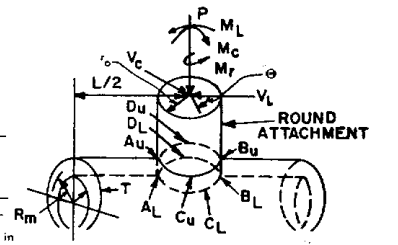

In [76]:
Image('direçao_wrc.png')

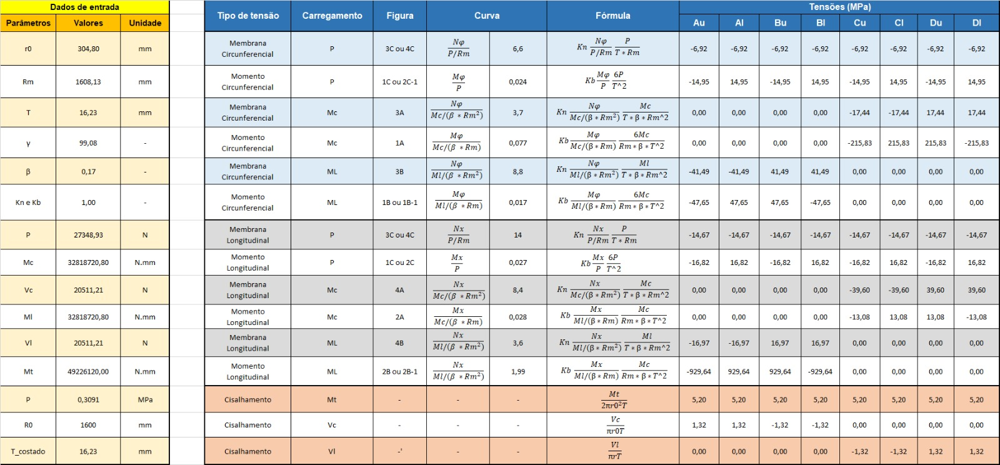

In [77]:
Image('wrc_107_tab1.jpeg',width=1000)

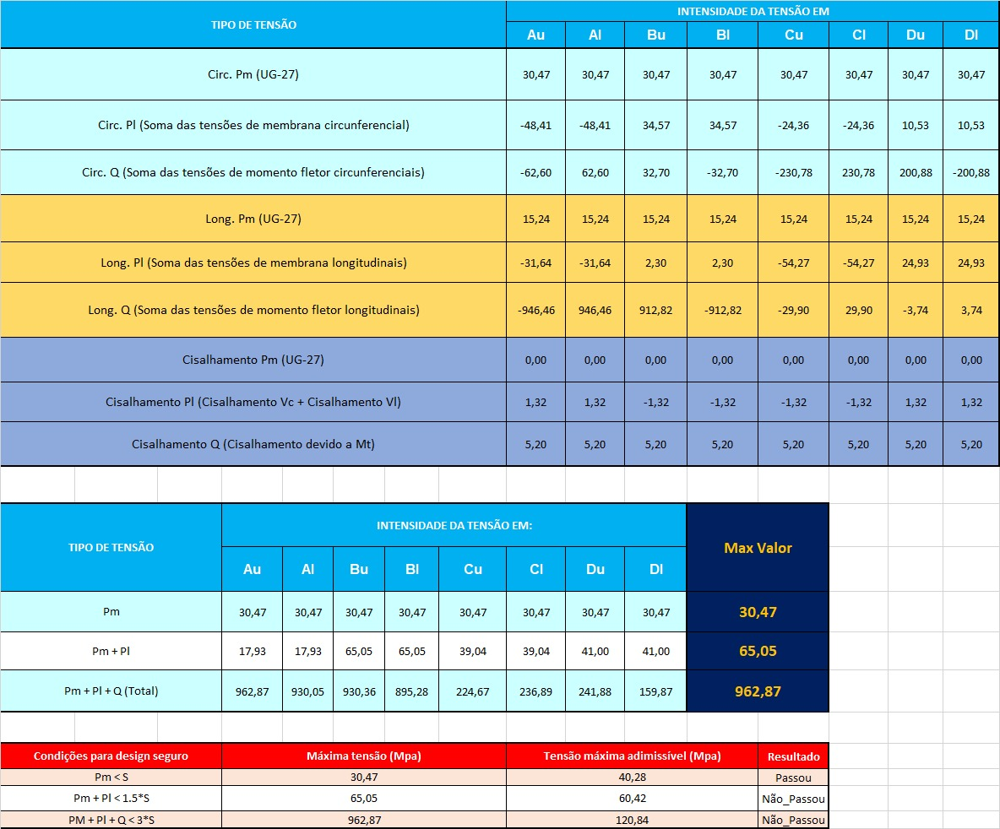

In [78]:
Image('wrc_107_tab2.jpeg',width=700)

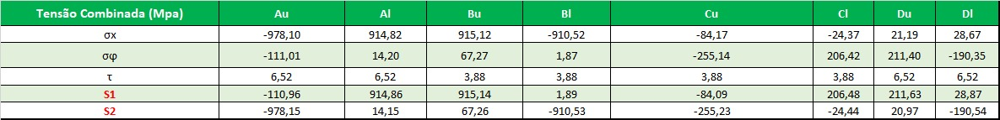

In [79]:
Image('tensoes_combinadas.jpeg')

### 2.9.4 Dimensionamento do flange

Para o dimensionamento do flange, levou-se em consideração as informações fornecidas pelo enunciado, aonde DN = 24 pol. e a classe de pressão era 150#. A partir desses dados, procurou-se um catálogo comercial com o intuito de se obter mais informações acerca da geometria do bocal. Esse catálogo pertence à empresa [Valaço](https://www.valaco.com.br/produtos/conexoes_flg_wn_ANSI_150.html)
 mas está de acordo com valores da CONFORJA.


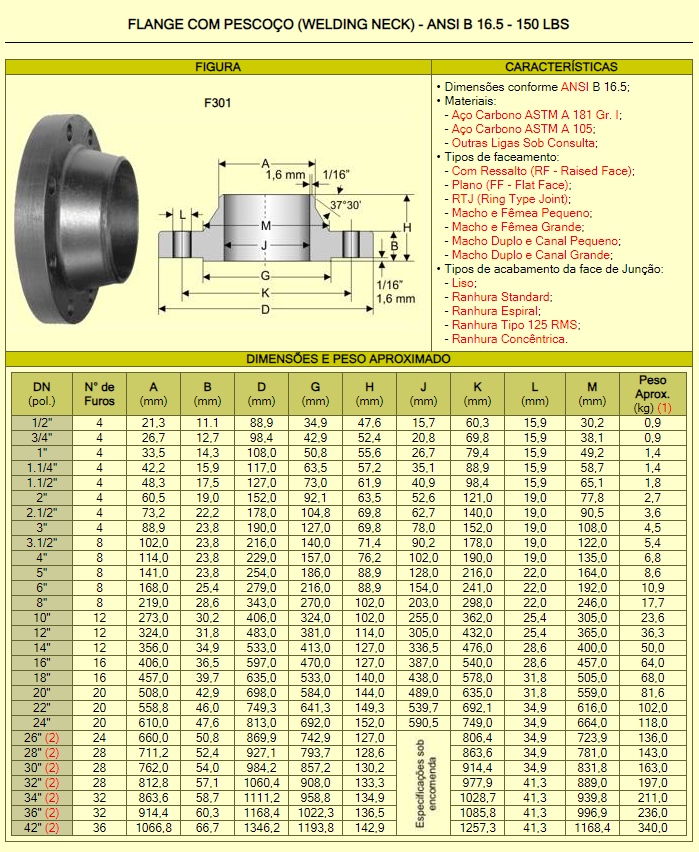

In [80]:
Image('bocal_valaço.png')

Abaixo, segue um modelo do flange construído no Inventor.

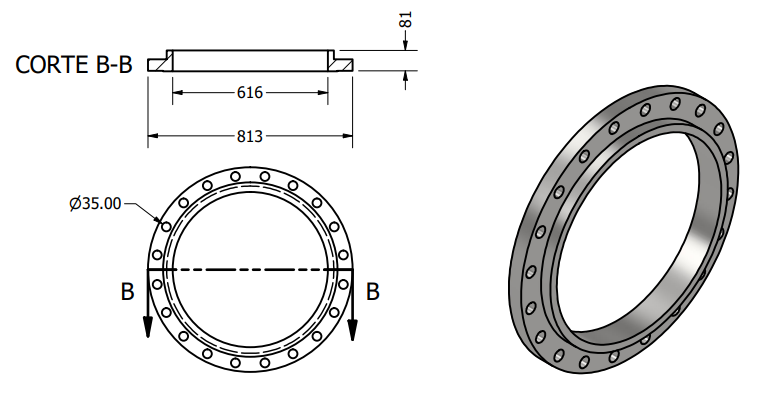

In [81]:
Image('FLANGE.png')

## 2.10 Tensões e fator de segurança

Nesta seção, serão apresentados os cálculos analíticos para a tensão de Von Mises, aonde para tal é preciso calcular as tensões circunferenciais e longitudinais atuando no vaso, levando em consideração a pressão de operação, que segundo o enunciado é 0,9 kgf/cm^2.

In [82]:
class Tensões_FS():
    def __init__(self,e,R,P_0,S_adm):   
        self.e = e      # Armazena o valor da espessura 
        self.R = R      # Armazena o valor do raio interno
        self.P_0 = P_0  # Armazena o valor da pressão de operação em kgf/cm^2
        self.S_adm = S_adm  # Armazena o valor da tensão admissível do projeto na temperatura especificada

    def sigma_circ(self):
        # Função que calcula a tensão circunferencial
        s_c = ((self.P_0 * 0.0980665) * self.R) / self.e

        global s_cg
        s_cg = s_c

        return s_c
    
    def sigma_long(self):
        # Função que calcula a tensão longitudinal
        s_l = s_cg / 2

        global s_lg
        s_lg = s_l

        return s_l
    
    
    def sigma_vm(self):
        # Função que calcula a tensão de Von Mises
        sigma_vm = np.sqrt(((s_cg - s_lg)**2) + ((s_lg - 0)**2) + ((0 - s_cg)**2))

        global sigma_vmg
        sigma_vmg = sigma_vm

        return sigma_vm
    
    def FS(self):
        # Função que calcula o fator de segurança que é dado pela razão entre a tensão adimissível e a tensão de Von Mises
        FS = self.S_adm / sigma_vmg

        return FS 

### 2.10.1 Condições de Projeto

In [83]:
VP_projeto = Tensões_FS(16.23,1600,3.1529,138.93)

A tensão circunferencial é dada por:

$$
\sigma_{\phi} = \frac{p \cdot r}{t}
$$

In [84]:
print(f'A tensão circunferencial de projeto é {VP_projeto.sigma_circ():.2f} MPa.')

A tensão circunferencial de projeto é 30.48 MPa.


A tensão longitudinal é dada por :

$$ \sigma_l = \frac{p \cdot r}{2t} $$

In [85]:
print(f'A tensão longitudinal de projeto é {VP_projeto.sigma_long():.2f} MPa.')

A tensão longitudinal de projeto é 15.24 MPa.


A tensão de Von Mises é:
$$\sigma_{VM} = \sqrt{(\sigma_1 - \sigma_2)^2 + (\sigma_2 - \sigma_3)^2 + (\sigma_3 - \sigma_1)^2}$$


In [86]:
print(f'A tensão de Von Mises para os dados do projeto é {VP_projeto.sigma_vm():.2f} MPa.')

A tensão de Von Mises para os dados do projeto é 37.33 MPa.


O fator de segurança é: 
 $$ FS = \frac{\sigma_{y}}{\sigma_{vm}}
$$

In [87]:
print(f'O fator de segurança para as condições de operação é {VP_projeto.FS():.2f}.')

O fator de segurança para as condições de operação é 3.72.


### 2.10.2 Condições de operação

In [88]:
VP_operação = Tensões_FS(16.23,1600,0.9,138.93)

In [89]:
print(f'A tensão circunferencial de operação é {VP_operação.sigma_circ():.2f} MPa.')

A tensão circunferencial de operação é 8.70 MPa.


In [90]:
print(f'A tensão longitudinal de operação é {VP_operação.sigma_long():.2f} MPa.')

A tensão longitudinal de operação é 4.35 MPa.


In [91]:
print(f'A tensão de Von Mises nas condições de operação é {VP_operação.sigma_vm():.2f}')

A tensão de Von Mises nas condições de operação é 10.66


In [92]:
print(f'O fator de segurança do projeto nas condições de operação é {VP_operação.FS():.2f}.')

O fator de segurança do projeto nas condições de operação é 13.04.


## 2.11 Análise de tensões pela Divisão 2 do ASME


### 2.11.1 Tensões primárias


Esse tipo de tensão são desenvolvidas por carregamentos capazes de satisfazer as leis de equilíbrio de forças e momentos atuantes no vaso de pressão, e caso excedam o limite de escoamento do material, o equipamento tende a falhar. Pode ser dividida em três categorias, detalhadas a seguir:

As **tensões de membrana generalizadas** ($P_m$) estão presentes em descontinuidades e concentradores de tensão e são ocasionados por esforços mecânicos aplicados de maneira uniforme, como a pressão. Portanto, neste projeto a $P_m$ é encontrada na área total do casco e no centro do tampo.


As **tensões de membrana localizada** ($P_l$) existem próximas a descontinuidades, ocasionadas por forças mecânicas. Dessa forma, em um porjeto de vaso de pressão, elas podem ser encontradas nas áreas de descontinuidades das soldas, entre os tampos e o casco, entre o casco e os bocais e entre os tampos e os bocais.

As **tensões de flexão** ($P_b$) existem em locais longes de descontinuidade e concentração de tensão e são ocasionadas por forças mecânicas. Para vasos de pressão de parede fina, ou seja, que possuem $\frac{R}{e}\geq 10$, pode ser considerada desprezível.

Com esse plano de fundo estabelecido, os valores limites para essas tensões são expostas pela divisão 2 do ASME, segundo a figura abaixo:






### 2.11.2 Tensões secundárias

As tensões secundárias são causadas principalmente por forças mecânicas e reações devido a expansão térmica. Sua principal característica é não provocar a falha do equipamento mesmo atingindo o limite de escoamento, pois ela provoca uma redistribuição de tensão. A essa característica dá-se o nome de "self-limiting". Elas estão localizadas dm descontinuidades.

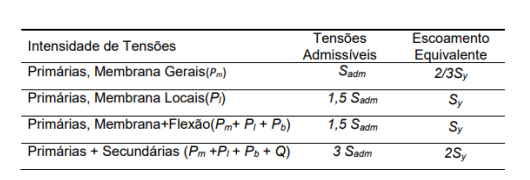

In [93]:
Image("asme_div 2.png")

In [94]:
class asme_div2():
    def __init__(self,S_adm,S_y):
        self.S_adm = S_adm
        self.S_y = S_y
    
    def Lim_Pm(self):
        S_adm1 = self.S_adm
        Sy_eq1= self.S_y * (2/3)

        if S_adm1 > Sy_eq1:
            print(f' Pm = {S_adm1:.2f} MPa, visto que S_adm > Sy_eq .')
        else:
            print(f'Pm = {Sy_eq1:.2f} MPa, visto que Sy_eq > S_adm.')

    def Lim_Pl(self):
        S_adm2 = 1.5 * self.S_adm
        Sy_eq2 = self.S_y

        if S_adm2 > Sy_eq2:
            print(f' Pl = {S_adm2:.2f} MPa, visto que S_adm > Sy_eq.')
        else:
            print(f'Pl = {Sy_eq2:.2f} MPa, visto que Sy_eq > S_adm.')


    

    def Pm_Flexao(self):
        S_adm3 = 1.5 * self.S_adm
        Sy_eq3 = self.S_y

        if S_adm3 > Sy_eq3:
            print(f' Pmlb = {S_adm3:.2f} MPa, visto que S_adm > Sy_eq.')
        else:
            print(f'Pmlb = {Sy_eq3:.2f} MPa, visto que Sy_eq > S_adm.')




    def Pri_sec(self):
        S_adm4 = 3 * self.S_adm
        Sy_eq4 = 2 * self.S_y

        if S_adm4 > Sy_eq4:
            print(f' Pmlb = {S_adm4:.2f} MPa, visto que S_adm > Sy_eq.')
        else:
            print(f'Pmlb = {Sy_eq4:.2f} MPa, visto que Sy_eq > S_adm.')

In [95]:
s2 = Interpol(20.2,19.7,900,905,950) #Passou-se 485°C para 905 F
s2 = (s2*6.89476)
print(f'A tensão de escoamento para o aço a 485°C vale {s2:.2f} MPa.')

A tensão de escoamento para o aço a 485°C vale 138.93 MPa.


In [96]:
VP_div2 = asme_div2(s,s2)

In [97]:
VP_div2.Lim_Pm()

Pm = 92.62 MPa, visto que Sy_eq > S_adm.


In [98]:
VP_div2.Lim_Pl()

Pl = 138.93 MPa, visto que Sy_eq > S_adm.


In [99]:
VP_div2.Pm_Flexao()

Pmlb = 138.93 MPa, visto que Sy_eq > S_adm.


In [100]:
VP_div2.Pri_sec()

Pmlb = 277.86 MPa, visto que Sy_eq > S_adm.


### 2.11.3 Tensão de Pico

Essa tensão representa a maior tensão em uma região do equipamento, sendo importantes para análise de fadiga. A exemplo das tensões secundárias, as tensões de pico também não resultam em falha caso exceda o limite de escoamento, pois ocorre uma redistribuição de tensão.

As tensões de pico podem dar início a trincas ppor fadiga, e alguns exemplos são citados abaixo:

- Tensões nos cantos de descontinuidade;
- Tensões térmicas em paredes ocasionadas por uma mudança abrupta de temperatura;
- Tensões térmicas em revestimentos ou sobreposição de solda;
- Tensões devido ao efeito de entalhe;

## 2.12 Análise de Elementos Finitos (AEF)

As AEFs a seguir foram conduzidas no $\textit{software}$ Autodesk Nastram, e visaram mostrar alguns resultados de simulações no vaso projeto em algumas situações.

Para todos os casos, adotou-se a condição mais crítica a qual o vaso estaria sujeito, isto é, quando a sua margem de corrosão tiver sido perdida.

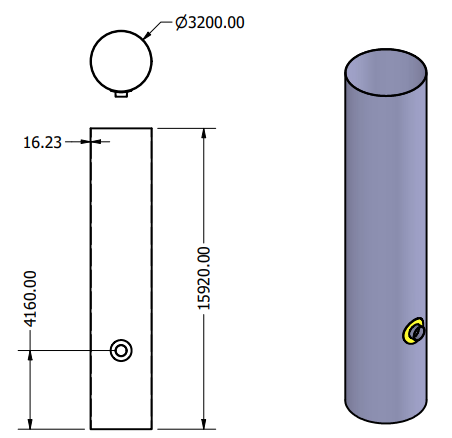

In [101]:
Image('vaso_versao1.png')

### 2.12.1 VP sem reforço e sem carregamento externo no bocal

- Configuração da malha do VP:

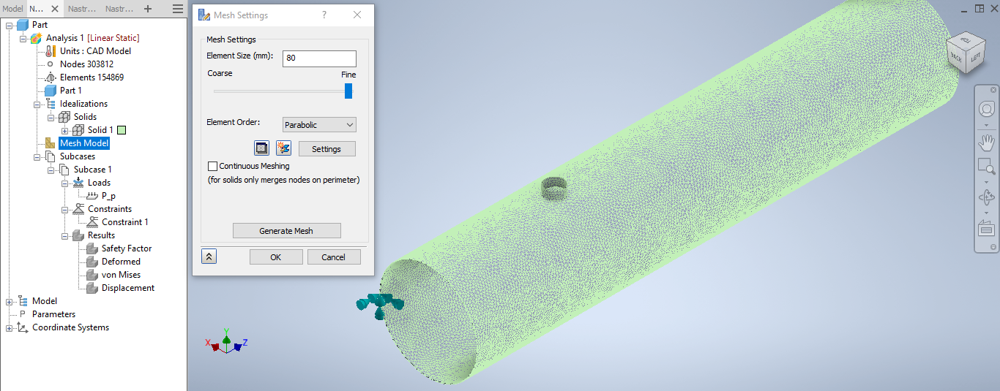

In [102]:
Image('VP_sem_anel_sem_f_externa.png',width=700)

- Tensão de Von Mises:

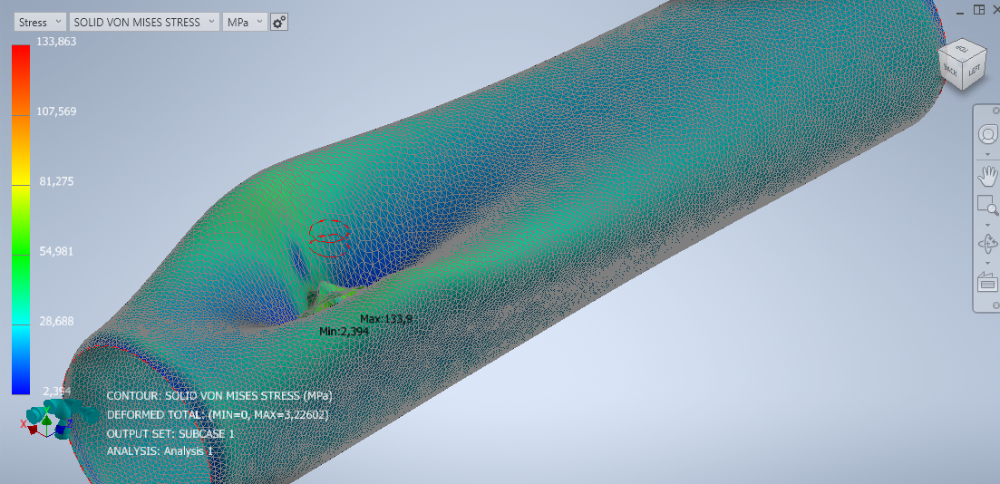

In [103]:
Image('VP_sem_anel_sem_f_externa_von_mises.png',width=700)

- Deslocamento:

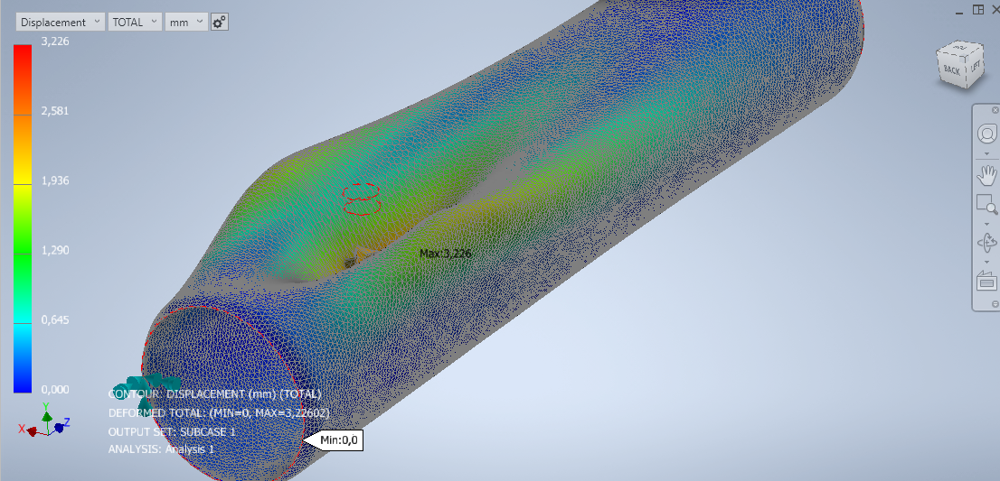

In [104]:
Image('VP_sem_anel_sem_f_externa_Displacement.png',width=700)

- Fator de segurança:

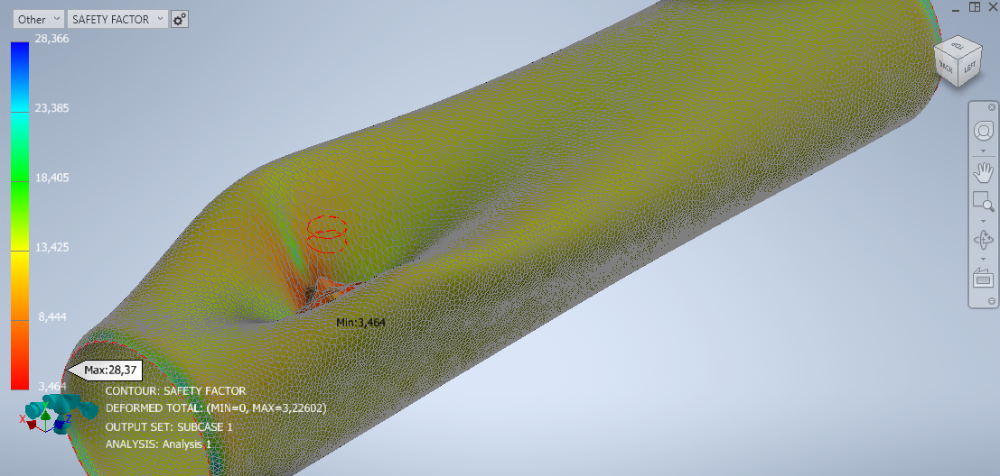

In [105]:
Image('VP_sem_anel_sem_f_externa_FS.png',width=700)

### 2.12.2 VP sem anel de reforço e com carregamento externo (caso mais crítico)

- Tensão de Von Mises:

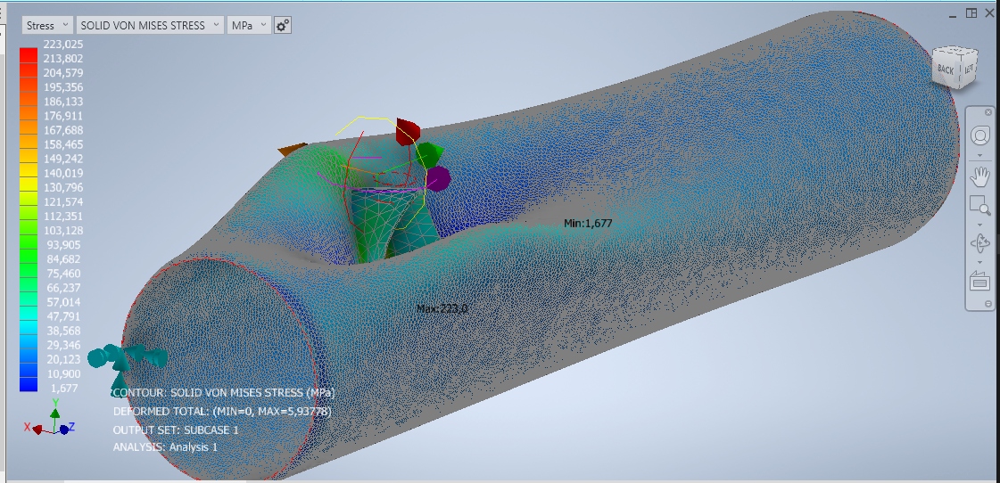

In [106]:
Image("VP_fraco_Von Mises.png",width=700)

- Deslocamento:

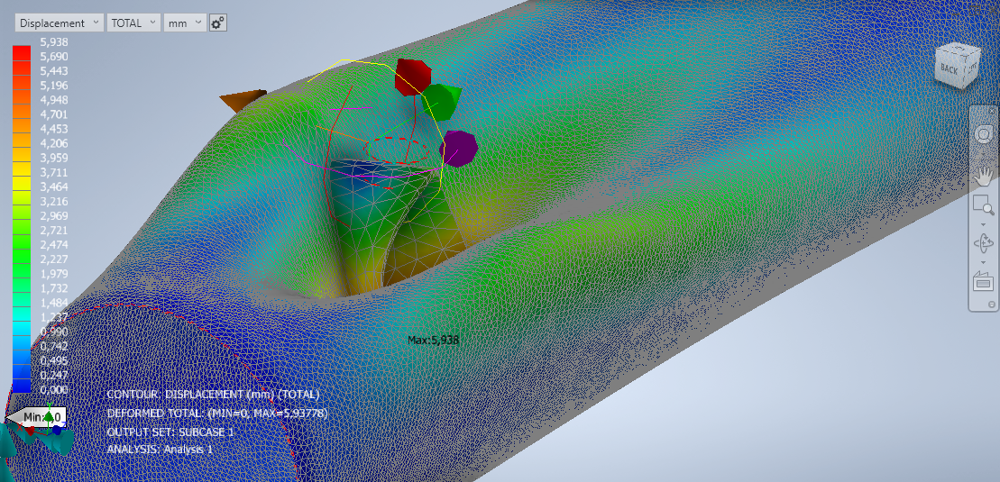

In [107]:
Image('VP_fraco_disp.png',width=700)

In [108]:
Video('vaso_fraco_1.m4v',width=700)

- Fator de Segurança:

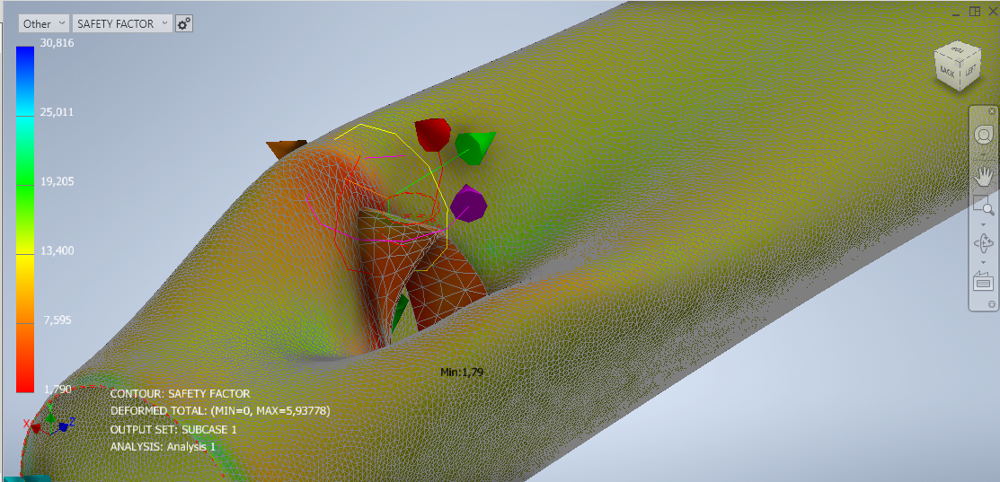

In [109]:
Image('VP_fraco_FS.png',width=700)

- Deformação:

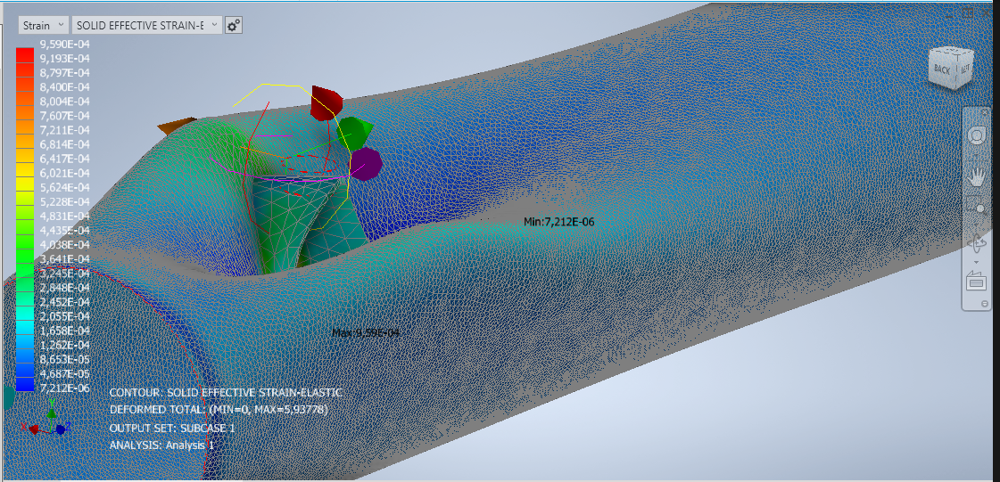

In [110]:
Image('VP_fraco_strain.png',width=700)

### 2.12.3 VP com anel de reforço sem carregamento no bocal

- Tensão de Von Mises:

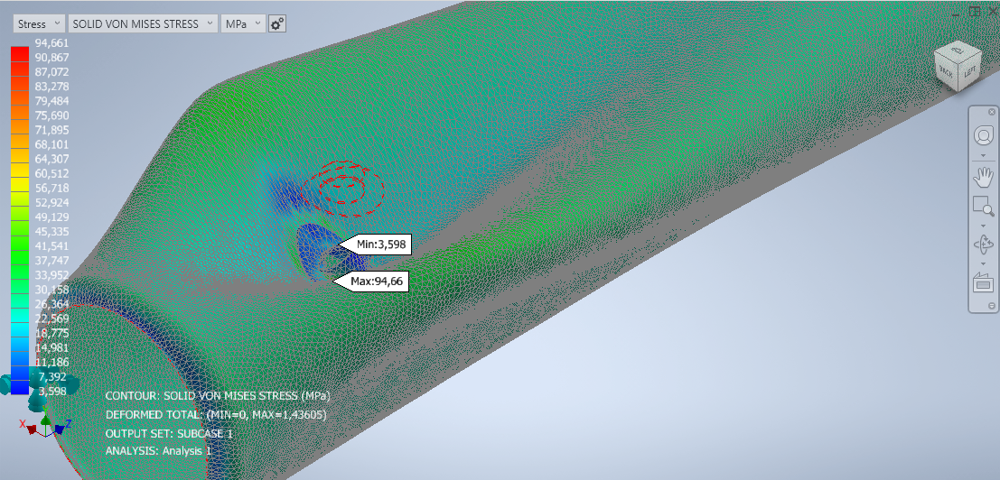

In [111]:
Image('VP_esp_16_sem_f_ext_Von Mises.png',width=700)

- Deslocamento:

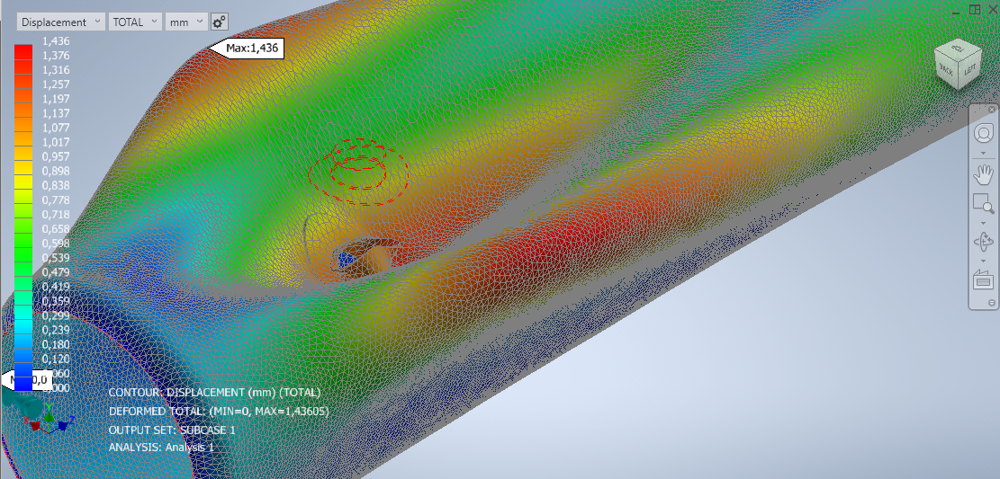

In [112]:
Image('VP_esp16_sem_f_ext_disp.png',width=700)

- Fator de segurança:

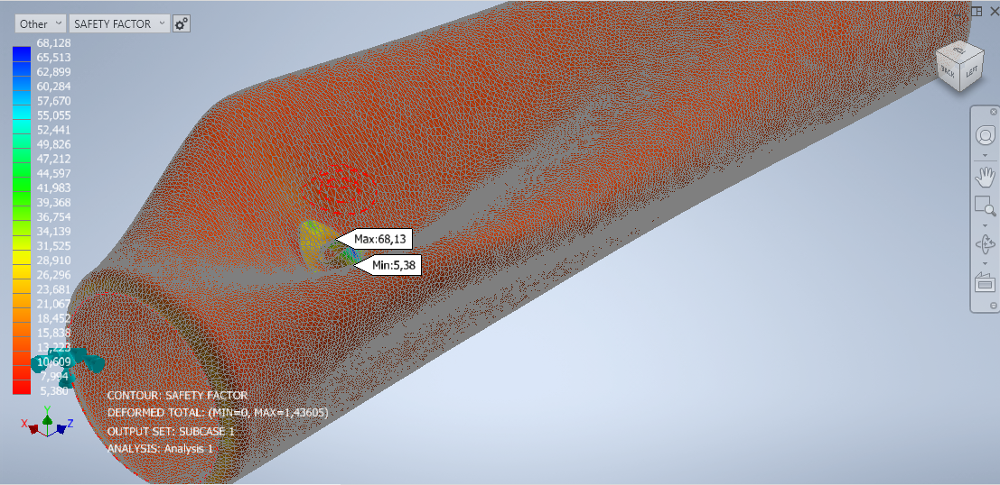

In [113]:
Image('VP_esp_16_sem_f_ext_FS.png',width=700)

### 2.12.4 VP com o anel de reforço e com o carregamento no bocal

- Tensão de Von Mises:

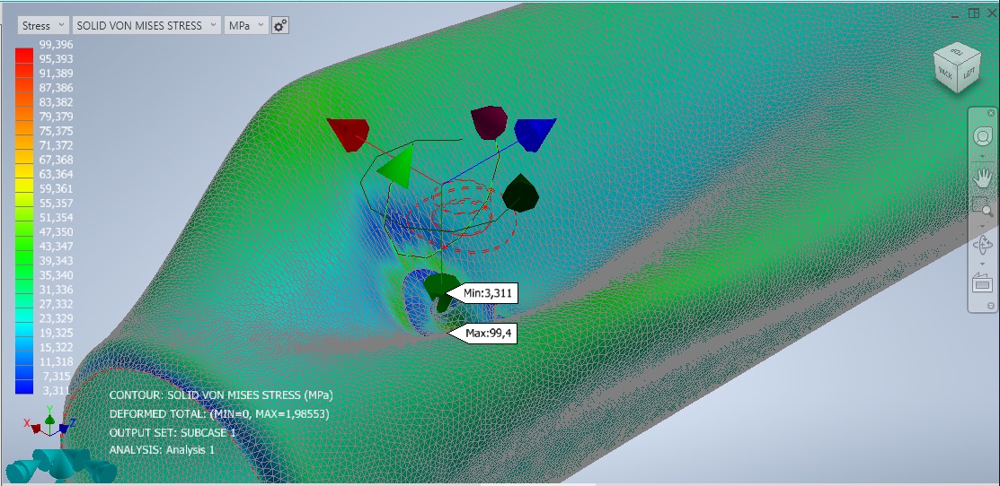

In [114]:
Image('VP_esp16_comF_Von Mises.png',width=700)

- Deslocamento:

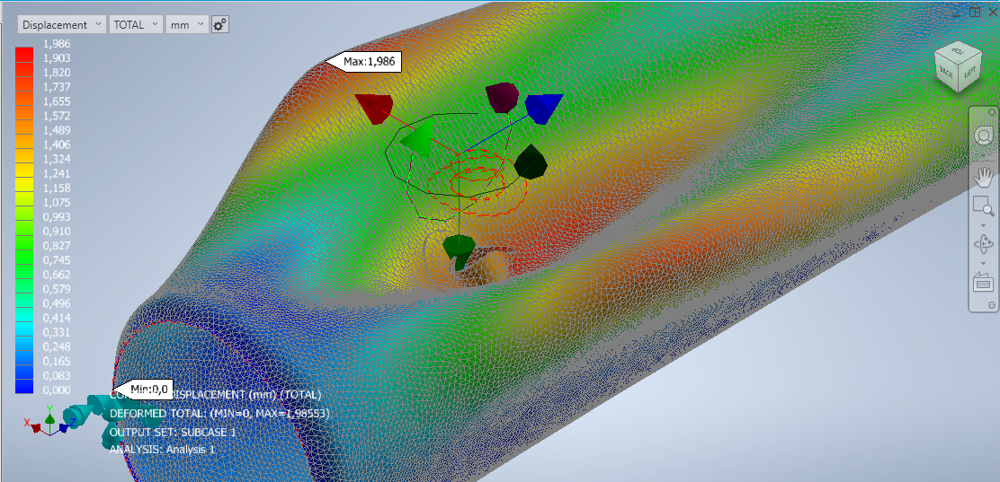

In [115]:
Image('VP_esp_16_comF_disp.png',width=700)

- Fator de Segurança:

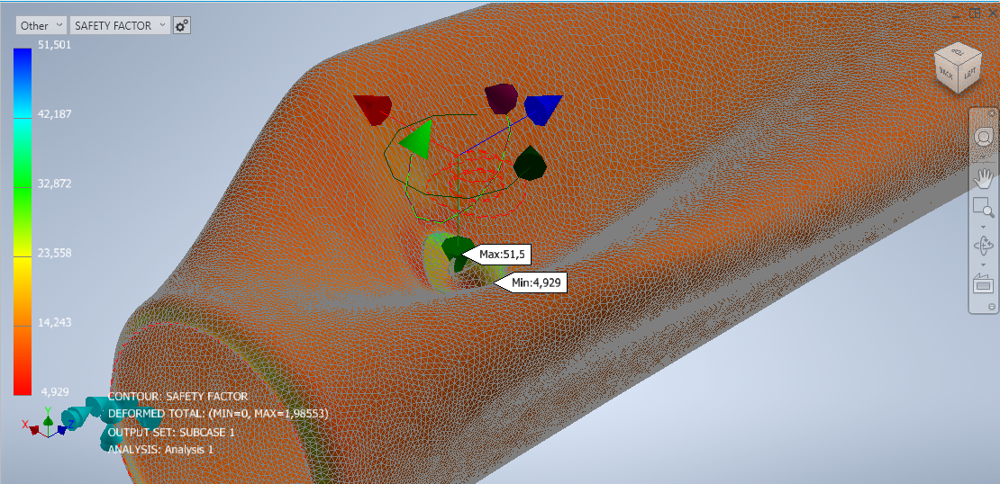

In [116]:
Image('VP_esp_16_comF_FS.png',width=700)

### 2.12.5 VP com aumento de espessura e com carregamento no bocal

Com o objetivo de aumentar a segurança do projeto, aumentou-se a espessura do costado de 22,23 mm para 31,8 mm, que, ao retirar a margem de corrosão fica 25,8 mm

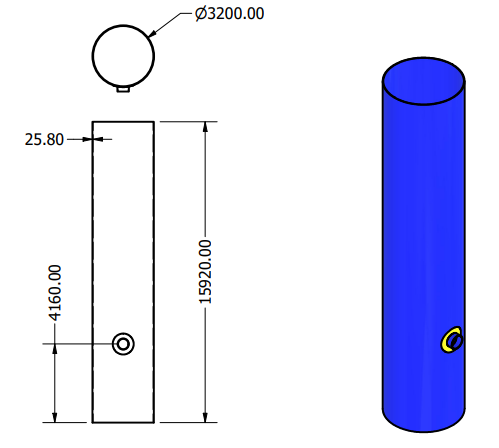

In [117]:
Image('vaso_final_esp25.png')

- Tensão de Von Mises:

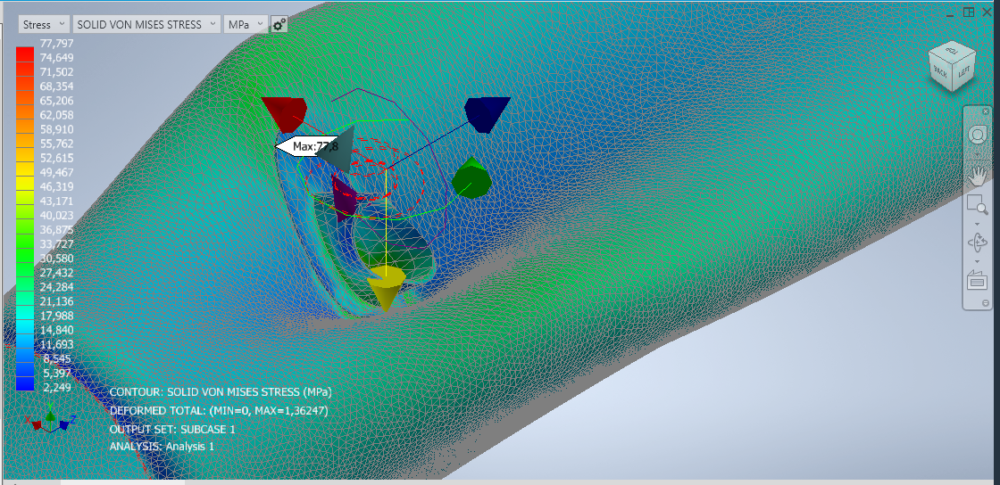

In [118]:
Image('Vaso_forte_Von Mises.png',width=700)

- Deslocamento:

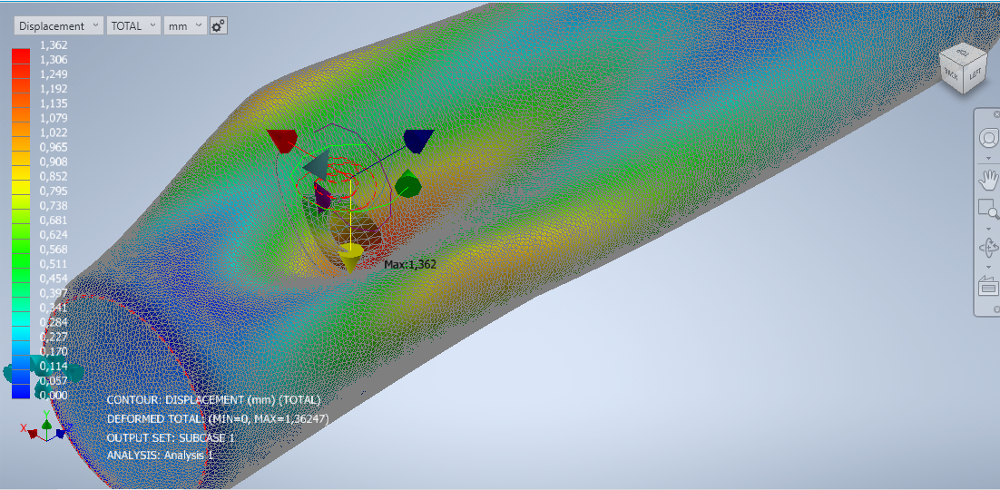

In [119]:
Image('Vaso_forte_disp.png',width=700)

In [120]:
Video('vaso_reforçado_anel.m4v',width=700)

- Fator de segurança:

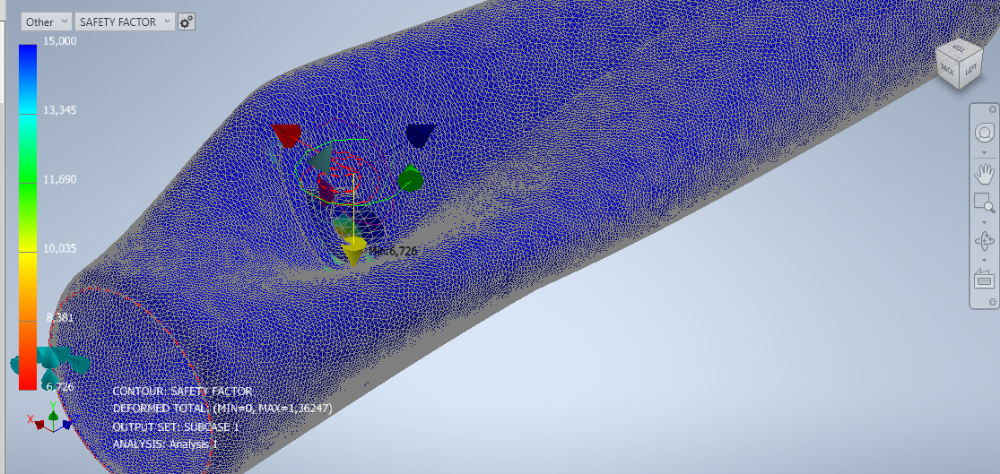

In [121]:
Image('VP_forte_FS.png',width=700)

- Deformação:

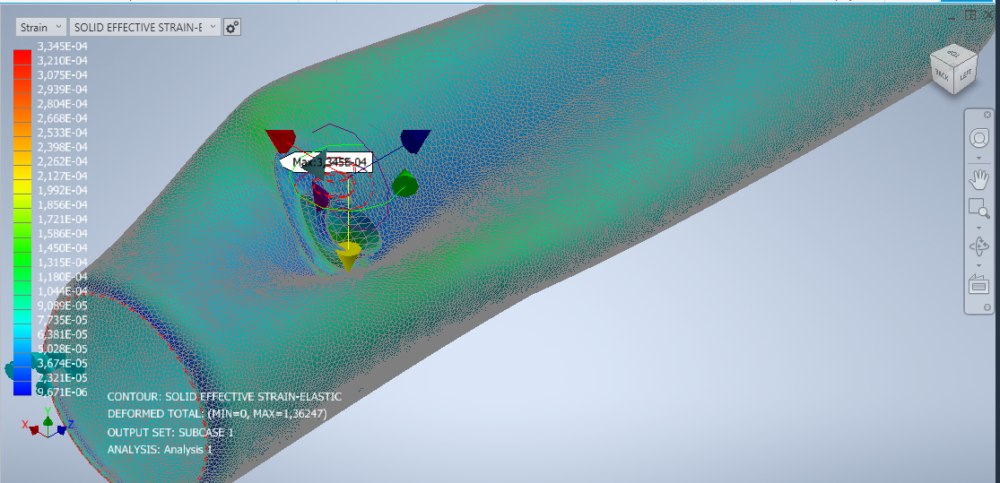

In [122]:
Image('VP_forte_strain.png',width=700)

### 2.15.6 Teste Hidrostático

Ao aplicar a pressão de teste hidrostático de 0,43914 MPs, tem-se esses resultados segundo AEF: 

- Tensão de Von Mises:

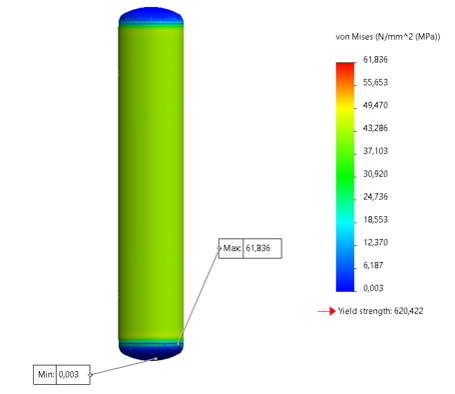

In [123]:
Image('Tensão_TH.png')

- Deformação:

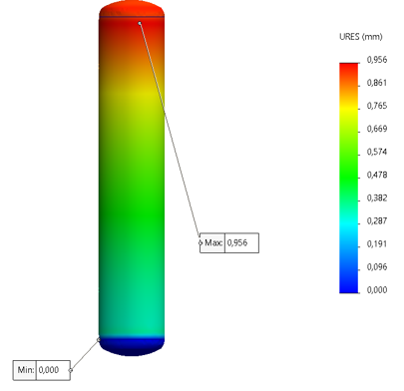

In [124]:
Image('deformação_TH.png')

- Fator de Segurança:

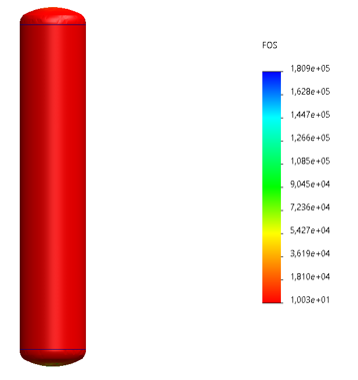

In [125]:
Image('FS_TH.png')

### 2.12.7 Teste de Flambagem


Nessa seção, fez-se uma análise de flambagem da saia de sustentação vaso de pressão do projeto. Esse cálculo é essencial para garantir a estabilidade estrutural do sistema, tendo em vista que a saia é responsável por suportar o peso do vaso e resistir a várias forças externas, como vento, terremotos, e cargas internas provenientes da pressão do fluido armazenado. Dada a importância desse componente, a análise de flambagem visa avaliar a capacidade da saia de suportar essas cargas sem perder sua integridade estrutural.

- Tensão de Von Mises:

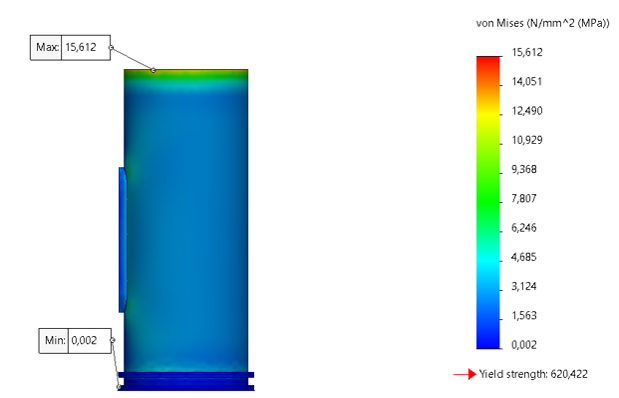

In [126]:
Image('VonMises_Flam.png')

- Deformação:

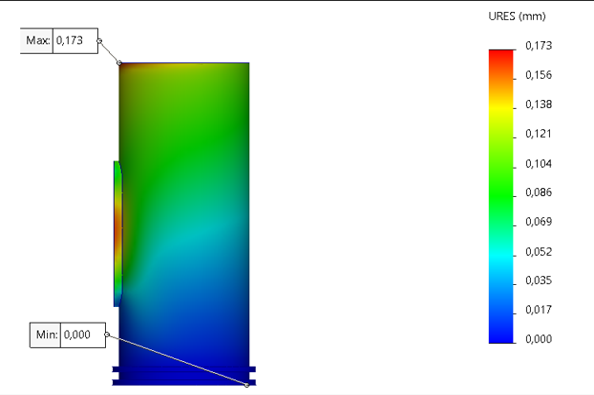

In [127]:
Image('def_Flam.png')

- Fator de segurança:

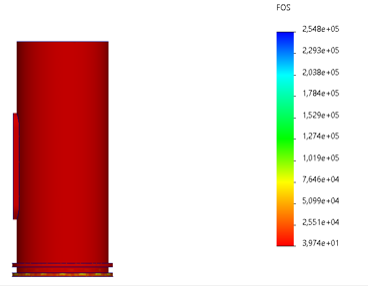

In [128]:
Image('FS_flam.png')

## 2.13 Resumo dos Resultados das AEFs:

<!DOCTYPE html>
<html>
<head>
  <style>
    table {
      width: 95%;
      border-collapse: collapse;
      margin: 20px 0;
    }
    th, td {
      border: 1px solid #dddddd;
      text-align: center;
      font-family: Arial, sans-serif;
      padding: 8px;
      box-shadow: 2px 2px 5px rgba(0, 0, 0, 0.1); /* Sombra nas células */
    }
    th {
      background-color: #0f20d6;
      color: white; /* Cor do texto em branco */
      font-weight: bold; /* Negrito */
    }
    tr:nth-child(even) {
      background-color: transparent;
    }
  </style>
</head>
<body>

<table>
  <tr>
    <th>Caso</th>
    <th>Tensão de Von Mises</th>
    <th>Deslocamento</th>
    <th>Fator de segurança</th>
  </tr>
  <tr>
    <td>VP s/ anel reforço e sem carregamento no bocal</td>
    <td>133,863 MPa</td>
    <td>3,226 mm</td>
    <td>3,464</td>
  </tr>
  <tr>
    <td>VP s/ anel de reforço e com carregamento bocal</td>
    <td>223,025 MPa</td>
    <td>5,938 mm</td>
    <td>1,79</td>
  </tr>
  <tr>
    <td>VP c/ anel de reforço e sem carregamento no bocal</td>
    <td>94,66 MPa</td>
    <td>1,436 mm</td>
    <td>5,38</td>
  </tr>
  <tr>
    <td>VP c/ anel de reforço e com o carregamento no bocal</td>
    <td>99,4 MPa</td>
    <td>1,986 mm</td>
    <td>4,929</td>
  </tr>
  <tr>
    <td>VP c/ anel de reforço e aumento de espessura do costado</td>
    <td>77,797 MPa</td>
    <td>1,362 mm</td>
    <td>6,726</td>
  </tr>
    <tr>
    <td>Teste Hidrostático</td>
    <td>61,836 MPa</td>
    <td>0,956 mm</td>
    <td>1,003</td>
  </tr>
    <tr>
    <td>Flambagem</td>
    <td>15,612 MPa</td>
    <td>0,173 mm</td>
    <td>3,974e+01</td>
  </tr>
  
</table>

</body>
</



# 3.0 Conclusão


Com base nos resultados obtidos e na análise das tensões no bocal, conclui-se que, embora os cálculos do costado não tenham revelado sinais de falha, as tensões localizadas na região do bocal representam um risco significativo à integridade estrutural do vaso de pressão. A presença de concentrações de tensões nesses pontos críticos, como demonstrado pela análise, pode potencialmente levar a falhas sob condições operacionais.

Portanto, é imperativo considerar o aumento da espessura do costado como uma medida de reforço, visando não apenas atender aos requisitos normativos, mas também proporcionar um nível adicional de segurança ao projeto. Essa modificação no design estrutural do vaso de pressão contribuirá para a mitigação dos riscos associados às tensões elevadas no bocal, garantindo a robustez e a confiabilidade do equipamento ao longo de sua vida útil, mesmo sob condições adversas.

# 4.0 Referências bibliográficas

- TELLES, Pedro C. Silva. Vasos de pressão. 2. ed. Rio de Janeiro: LTC, 2009.

- NICOLA, Marcelo Dalvi; VIEIRA, Marcos Fernando Neto. Projeto mecânico e construção de vaso de pressão: estudo do caso serviço com sulfeto de hidrogênio. 2012. Trabalho de Conclusão de Curso (Graduação em Engenharia Mecânica) – Universidade Federal do Espírito Santo, Vitória, 2012.

- ENSUS Advanced Engineering. ANÁLISE DE TENSÕES ASME VIII - DIV 2. Postado em 25 de maio de 2018. Análise de Falha, ASME VIII - Div2, Elementos Finitos. Disponível em: https://ensus.com.br/analise-tensao-asme-viii-div2/#:~:text=Tens%C3%B5es%20Prim%C3%A1rias%3A,ou%20pelo%20menos%20grandes%20distor%C3%A7%C3%B5es. Acesso em: 17 ago. 2024.

- WELDING RESEARCH COUNCIL (WRC). WRC Bulletin 107: Local Stresses in Spherical and Cylindrical Shells Due to External Loadings. New York: WRC, 1965.

- MOSS, Dennis R. Pressure-Vessel Design and Construction. New York: McGraw-Hill, 2004.

